<a href="https://colab.research.google.com/github/TaisiaKozharina/WSI_artifact_segmentation/blob/main/bach.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 0. Imports

In [1]:
! pip install imagecodecs
! pip install clustimage
! pip install -U clustimage

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 39.6/39.6 MB 42.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 51.3/51.3 kB 4.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.0/42.0 kB 5.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.4/42.4 kB 4.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 26.0 MB/s eta 0:00:00


In [2]:
!nvidia-smi

Fri May 10 15:18:06 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   40C    P8               9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [3]:
# NN related
import torch
from torch import nn
import torchvision
from torchvision import transforms
from torchvision.transforms import v2
from torchvision.transforms.v2 import ToTensor
from torch.utils.data import DataLoader
from torchvision.transforms import ToPILImage

# Data preprocessing
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils
import torchvision.transforms.functional as F
from torch.nn.functional import max_pool2d
from glob import glob
from tifffile import imread
from PIL import Image
from pathlib import Path
from skimage import measure
from skimage import color

# Other
import random
import os
import matplotlib.pyplot as plt
import numpy as np
import time
from tqdm.auto import tqdm # progress bar



In [4]:
print("Torch version: ", torch.__version__)
print("TorchVision version: ", torchvision.__version__)

Torch version:  2.2.1+cu121
TorchVision version:  0.17.1+cu121


In [5]:
! python3 --version

Python 3.10.12


In [6]:
device = "cuda" if torch.cuda.is_available() else "cpu"
print(f"Device: {device}")

Device: cuda


# 1. READING DATA 💜

### 1.0. Mount Google Drive

In [7]:
from google.colab import drive
drive.mount('/content/drive',force_remount=True) # force_remount=True

# PATHS
bin_map_dir = '/content/drive/MyDrive/pathdata/bin_maps/*.tif'
originals_dir = '/content/drive/MyDrive/pathdata/component_data/*.tif'


Mounted at /content/drive


In [8]:
!ls "/content/drive/MyDrive/pathdata/"

bin_maps      component_data	segments	       small_segments_18px.txt
bin_maps_old  seg_final_FAILED	segments_with_padding


### 1.1 Data exploration: original channels

In [ ]:
original = torch.Tensor(imread(originals_dir.replace("*.tif", "BOMI2_TIL_1_Core[1,1,C]_[8663,35138]_component_data.tif"))).to("cpu")

print(original[0].shape)
print(torch.unique(original[0]))

print(original[6].shape)
print(torch.unique(original[6]))

print(original[7].shape)
print(torch.unique(original[7]))


torch.Size([2808, 3752])
tensor([0.0000e+00, 1.3161e-04, 1.5950e-04,  ..., 5.9534e+01, 5.9977e+01,
        6.0306e+01])
torch.Size([2808, 3752])
tensor([0.0000e+00, 8.2086e-07, 1.6211e-06,  ..., 6.3287e+01, 6.3304e+01,
        6.3327e+01])
torch.Size([2808, 3752])
tensor([0.0000e+00, 8.3787e-04, 5.0910e-03,  ..., 3.9386e+01, 3.9491e+01,
        4.1119e+01])


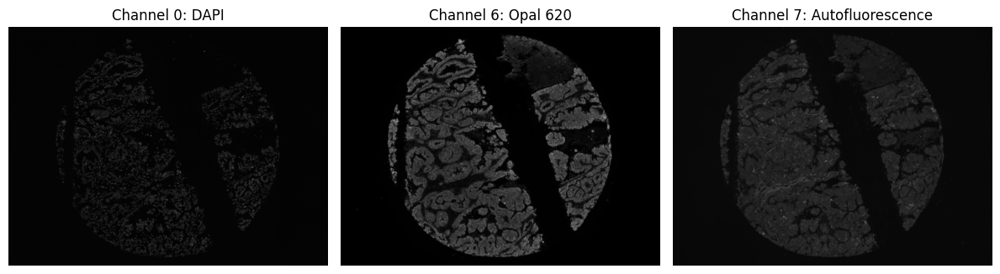

In [ ]:
fig,axes = plt.subplots(1, 3, figsize=(12, 18))

axes[0].imshow(original[0], cmap="gray")
axes[0].set_title(f"Channel 0: DAPI")
axes[0].axis('off')

axes[1].imshow(original[6], cmap="gray")
axes[1].set_title(f"Channel 6: Opal 620")
axes[1].axis('off')  # Turn off axis

axes[2].imshow(original[7], cmap="gray")
axes[2].set_title(f"Channel 7: Autofluorescence")
axes[2].axis('off')

plt.tight_layout()
plt.show()

torch.Size([3, 1])
tensor([[0.0000],
        [0.0000],
        [0.0667]])
torch.Size([3, 2808, 3752])


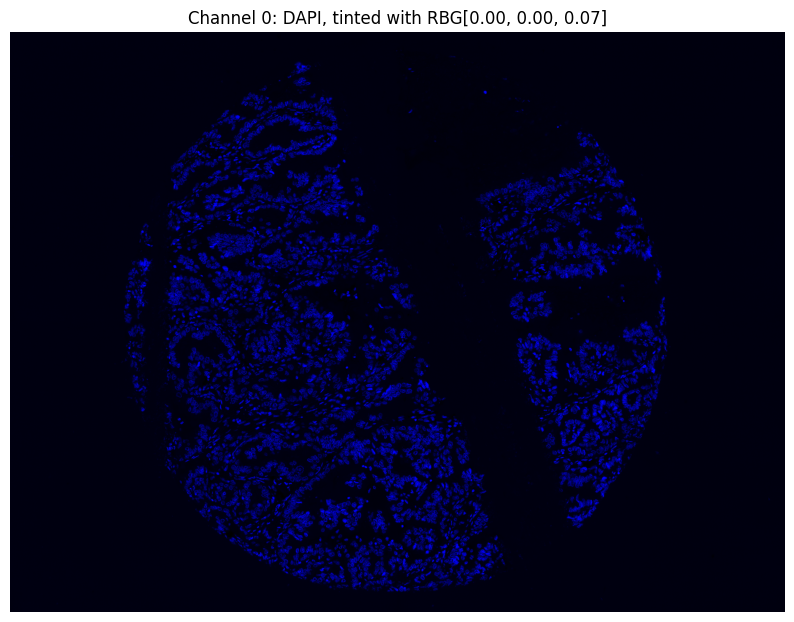

In [ ]:
tint_c0 = torch.Tensor([[0],[0], [100]])/1500
print(tint_c0.shape)
print(tint_c0)

color_channel_0 = original[0].repeat(3,1,1) * torch.unsqueeze(tint_c0,1)
print(color_channel_0.shape)

plt.figure(figsize=(10, 8))
plt.axis('off')
plt.title(f"Channel 0: DAPI, tinted with RBG[{tint_c0[0].item():.2f}, {tint_c0[1].item():.2f}, {tint_c0[2].item():.2f}]")
plt.imshow(color_channel_0.permute(1, 2, 0))

tensor([[0.0467],
        [0.0000],
        [0.0467]])


Error in callback <function _draw_all_if_interactive at 0x799140f11000> (for post_execute):


KeyboardInterrupt: 

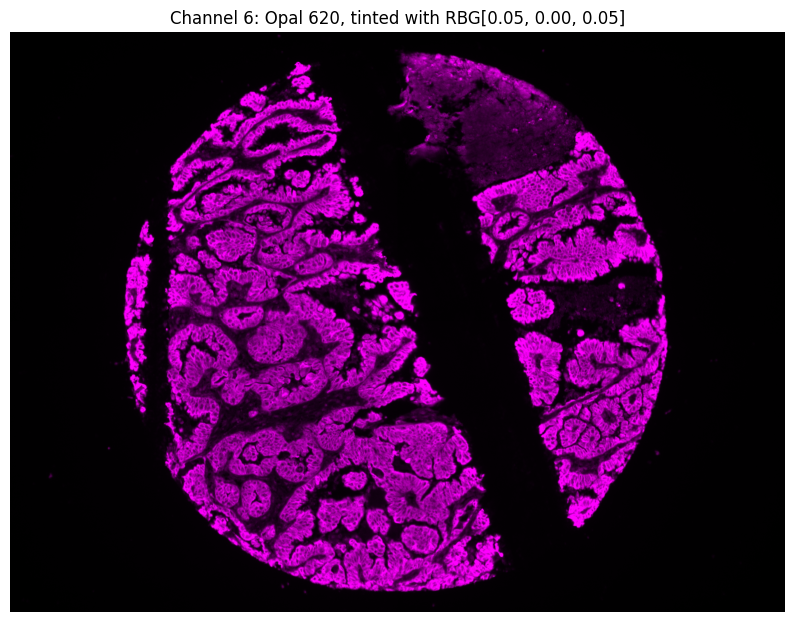

In [ ]:
tint_c6 = torch.Tensor([[70], [0], [70]])/1500
print(tint_c6)

color_channel_6 = original[6].repeat(3,1,1) * torch.unsqueeze(tint_c6,1)

plt.figure(figsize=(10, 8))
plt.axis('off')
plt.title(f"Channel 6: Opal 620, tinted with RBG[{tint_c6[0].item():.2f}, {tint_c6[1].item():.2f}, {tint_c6[2].item():.2f}]")
plt.imshow(color_channel_6.permute(1, 2, 0))


tensor([[0.0200],
        [0.0400],
        [0.0400]])


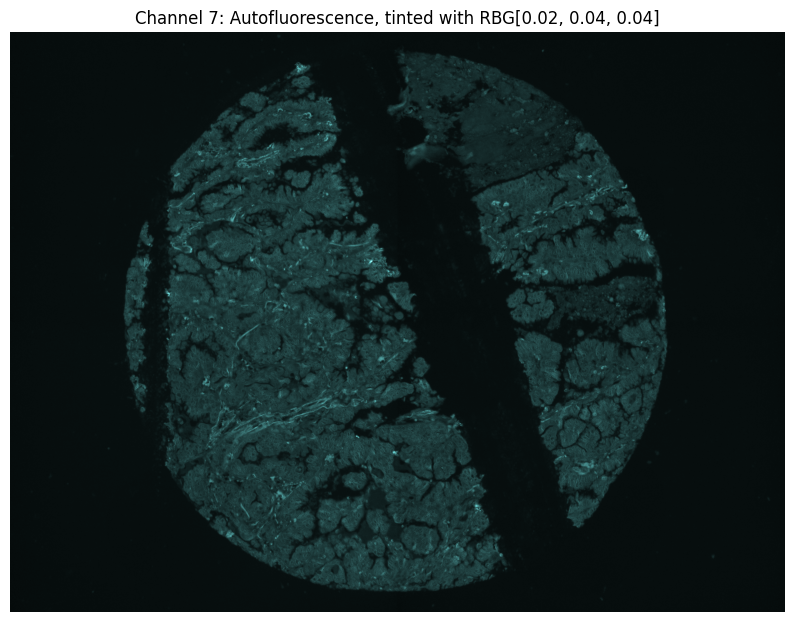

In [ ]:
tint_c7 = torch.Tensor([[30], [60], [60]])/1500
print(tint_c7)

color_channel_7 = original[7].repeat(3,1,1) * torch.unsqueeze(tint_c7,1)

plt.figure(figsize=(10, 8))
plt.axis('off')
plt.title(f"Channel 7: Autofluorescence, tinted with RBG[{tint_c7[0].item():.2f}, {tint_c7[1].item():.2f}, {tint_c7[2].item():.2f}]")
plt.imshow(color_channel_7.permute(1, 2, 0))

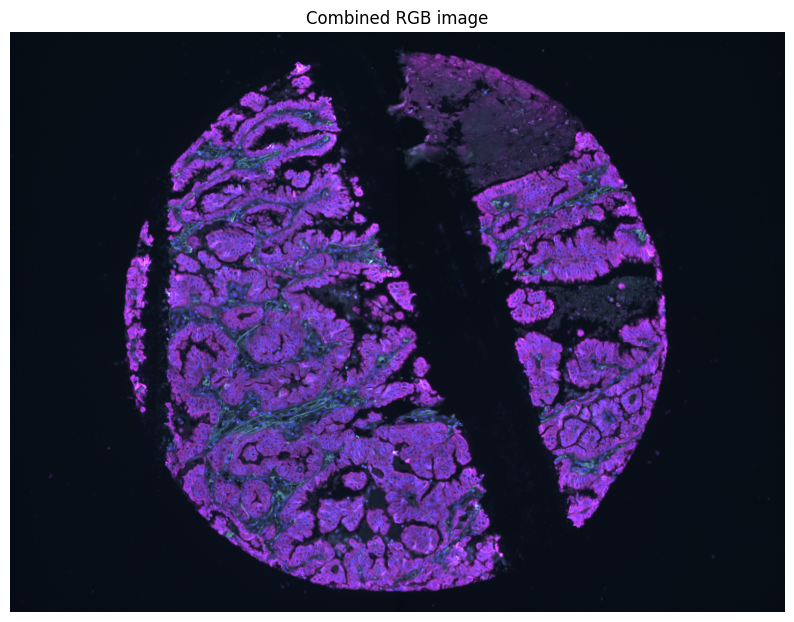

In [ ]:
alpha = 0.5
out = ((color_channel_0 * (1.0 - alpha) + color_channel_6 * alpha)*alpha + color_channel_7 * (1.0 - alpha))*2

plt.figure(figsize=(10, 8))
plt.axis('off')
plt.title(f"Combined RGB image")
plt.imshow(out.permute(1, 2, 0))

### 1.2. Define custom class for data samples

#### 1.2.1 Constants

In [9]:
# Tints for image coloring
tint_c0 = (torch.Tensor([[0],[0], [100]])/1500)
tint_c6 = (torch.Tensor([[70], [0], [70]]) / 1500)
tint_c7 = (torch.Tensor([[30], [60], [60]]) / 1500)

# Image augmentation constants
DOWNSAMPLE_HEIGHT = 1000
ALPHA = 0.5
MARGIN = 10




#### 1.2.2 Helper functions

In [10]:
def dilate_mask(mask: torch.Tensor, padding: int):
  '''
    Function to add padding to annotated segment mask using max pooling
  '''
  dilated_mask = max_pool2d(mask.unsqueeze(0), kernel_size=padding * 2 + 1, stride=1, padding=padding)
  dilated_mask = torch.where(dilated_mask > 0, 1, 0)

  return dilated_mask.squeeze(0)

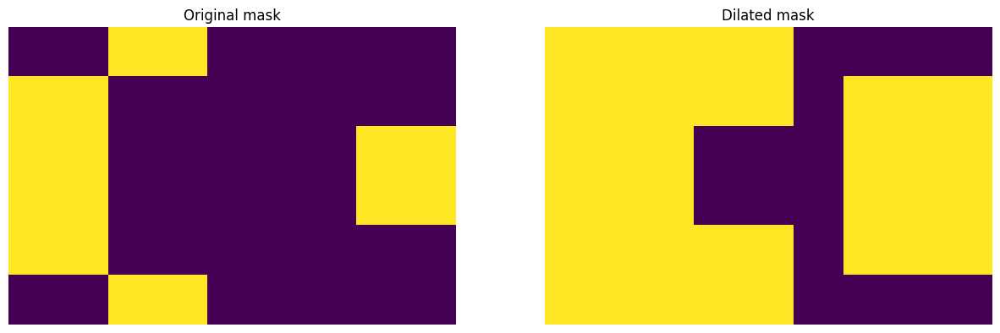

In [11]:
# Demo for dilation
mask = torch.tensor([
    [0, 0, 1, 1, 0, 0, 0, 0, 0],
    [1, 1, 0, 0, 0, 0, 0, 0, 0],
    [1, 1, 0, 0, 0, 0, 0, 1, 1],
    [1, 1, 0, 0, 0, 0, 0, 1, 1],
    [1, 1, 0, 0, 0, 0, 0, 0, 0],
    [0, 0, 1, 1, 0, 0, 0, 0, 0]
], dtype=torch.float32)


padding = 1
padded_mask = dilate_mask(mask, padding)

fig, axes = plt.subplots(1, 2, figsize=(15, 8))

axes[0].imshow(mask)
axes[0].axis('off')
axes[0].set_title('Original mask')
axes[1].imshow(padded_mask)
axes[1].axis('off')
axes[1].set_title('Dilated mask')

plt.show()

In [12]:
def color_WSI(path):
  '''
    Returns colored image as combination of 3 tinted channels, taking as input path of 8-channel original gray-scale image
  '''

  original = F.resize(torch.Tensor(imread(path)), [DOWNSAMPLE_HEIGHT])

  rbg_c0 = original[0].repeat(3,1,1)
  rbg_c6 = original[6].repeat(3,1,1)
  rbg_c7 = original[7].repeat(3,1,1)

  tinted_c0 = rbg_c0*torch.unsqueeze(tint_c0,1)
  tinted_c6 = rbg_c6*torch.unsqueeze(tint_c6,1)
  tinted_c7 = rbg_c7*torch.unsqueeze(tint_c7,1)

  out = torch.Tensor(((tinted_c0 * (1.0 - ALPHA) + tinted_c6 * ALPHA)*ALPHA + tinted_c7 * (1.0 - ALPHA))*2)

  return out

def extract_segmets(annotation, original):
  '''
    Returns individual (separated) segments cut outs taking as input original and annotation
  '''

  segments = []

  for channel in annotation:
    labeled = torch.Tensor(measure.label(channel, connectivity=2))
    labels = torch.unique(labeled)

    for label in labels[labels != 0]:
      mask = F.resize(torch.where(labeled == label, 1, 0).repeat(3,1,1), [DOWNSAMPLE_HEIGHT])
      masked_original = original * mask
      segments.append(masked_original)


  return segments

#### 1.1.2 Dataset class

In [13]:
class WSI_Dataset(Dataset):
    """
    Whole-Slide Image dataset

    Arguments:
          annotations_path (string): Path to the root folder on GDrive of annotations.
          images_path (string): Path to the root folder on GDrive of original WSI images.
          transform (callable, optional): Optional transform to be applied on a sample.

      __getitem___(self, index):
        Returns sample elements by index. Index is taken in respect to unordered dataset stored on google drive.
        * id: string, ID of sample
        * original: torch.tensor, RBG combination of 3 channels,
        * annotation: torch.tensor, Grayscale annotation map,
        * segments: list of RBG separated annotated segments

    """

    def __init__(self, annotations_path, images_path, transform=None):

      self.annotations_path = annotations_path
      self.images_path = images_path
      self.transform = transform
      #self.segment_margin = segment_margin
      self.cache = {}  # Dictionary to cache samples

    def __len__(self):
      return len(glob(self.annotations_path))

    def __iter__(self):
        for i in range(len(self)):
            yield self[i]

    def __getitem__(self, index):

      if index in self.cache:  # Check if sample is already cached
        return self.cache[index]

      if torch.is_tensor(index):
          index = index.tolist()

      annotation_path = sorted(glob(self.annotations_path))[index]
      ID = Path(annotation_path).name.replace("_binary_map.tif","")
      original_path = self.images_path.replace("*.tif", f"{ID}_component_data.tif")

      #print(f"Provided Index: {index} \nID: {ID} \nMap path: {annotation_path}\nOriginals path: {original_path} \nImages path: {self.images_path} \nBin path: {self.annotations_path}")

      if original_path in glob(self.images_path):
        original = color_WSI(original_path)
        annotation = torch.Tensor(imread(annotation_path).astype(np.float32))
        segments = extract_segmets(annotation, original)

      else:
        print(f"Corresponding original image file not found for sample: {ID}")
        original = torch.Tensor([])
        annotation = torch.Tensor([])
        segments = []

      sample = {
          'id': ID,
          'original': original,
          'annotation': annotation,
          'segments': segments
      }

      if self.transform:
          sample = self.transform(sample)

      self.cache[index] = sample  # Cache the sample

      return sample


#### 1.2.3 Declaring WSI dataset

In [14]:
wsi_samples = WSI_Dataset(bin_map_dir, originals_dir)

print(f"\n🔊 TOTAL SAMPLE SIZE: {len(wsi_samples)}")
#print(f"\n🔊 SAMPLE SHAPE: {wsi_samples[0]['original'].shape}")
print(f"\n🔊 SAMPLE SHAPE: {wsi_samples[0]['original'].shape[0]} channel(s) or dimensions [{wsi_samples[0]['original'].shape[1]} x {wsi_samples[0]['original'].shape[2]}]")
print(f"\n🔊 Sample {wsi_samples[0]['id']} has {len(wsi_samples[0]['segments'])} segments")


🔊 TOTAL SAMPLE SIZE: 117

🔊 SAMPLE SHAPE: 3 channel(s) or dimensions [1000 x 1336]

🔊 Sample BOMI2_TIL_1_Core[1,1,A]_[5091,35249] has 27 segments


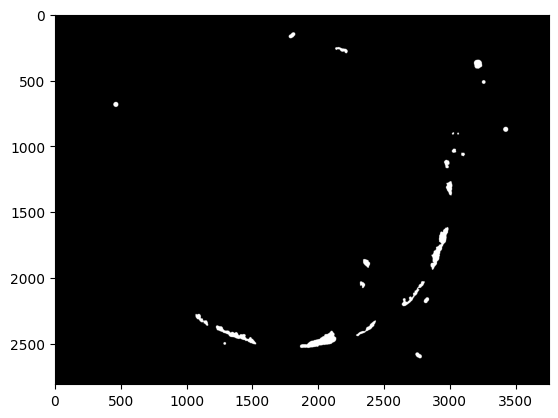

In [15]:
plt.imshow(wsi_samples[0]['annotation'][0], cmap="gray")

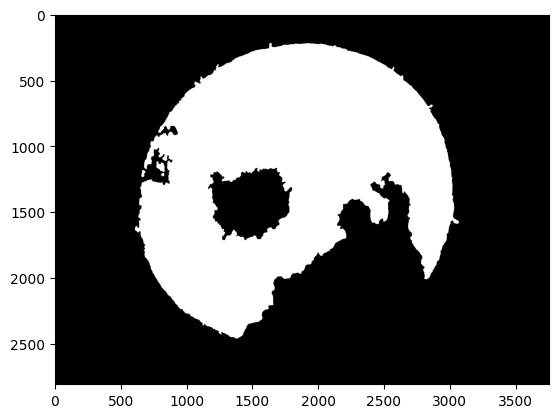

In [16]:
plt.imshow(wsi_samples[0]['annotation'][1], cmap="gray")

In [17]:
wsi_samples[0]['annotation'][1].shape

torch.Size([2808, 3752])

In [18]:
def plot_sample(sample):

  annotation_c1 = F.resize(sample['annotation'][0].unsqueeze(0),[sample['original'].shape[1], sample['original'].shape[2]]).squeeze(0)
  annotation_c1_mask = np.ma.masked_where(annotation_c1 == 0, annotation_c1)

  annotation_c2 = F.resize(sample['annotation'][1].unsqueeze(0),[sample['original'].shape[1], sample['original'].shape[2]]).squeeze(0)
  annotation_c2_mask = np.ma.masked_where(annotation_c2 == 0, annotation_c2)

  plt.figure(figsize=(15, 15))

  plt.title(f"Sample: {sample['id']} - annotations")

  plt.imshow(sample['original'].permute(1, 2, 0))
  plt.imshow(annotation_c1_mask, cmap='Wistia', interpolation='none', alpha=ALPHA)
  plt.imshow(annotation_c2_mask, cmap='gray', interpolation='none', alpha=ALPHA)

  plt.axis('off')
  plt.show()

Original shape: torch.Size([3, 1000, 1336])
Annotation (one channel) original shape: torch.Size([2808, 3752])
Annotation resized shape: torch.Size([1000, 1336])
Annotation resized shape: torch.Size([1, 1000, 1336])


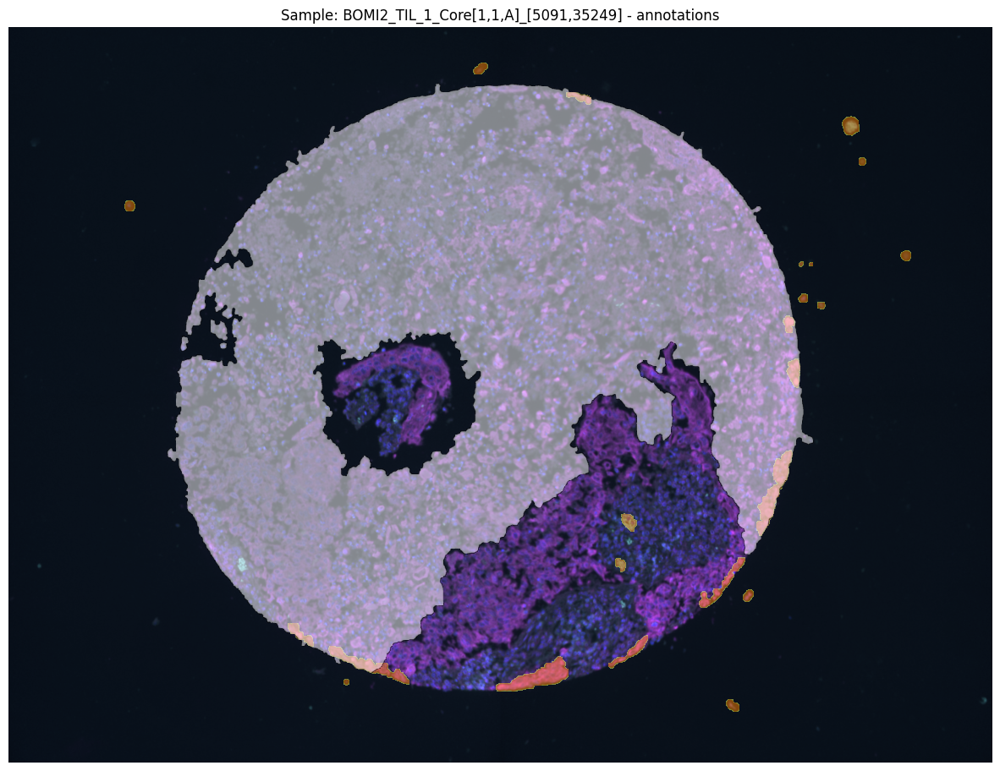

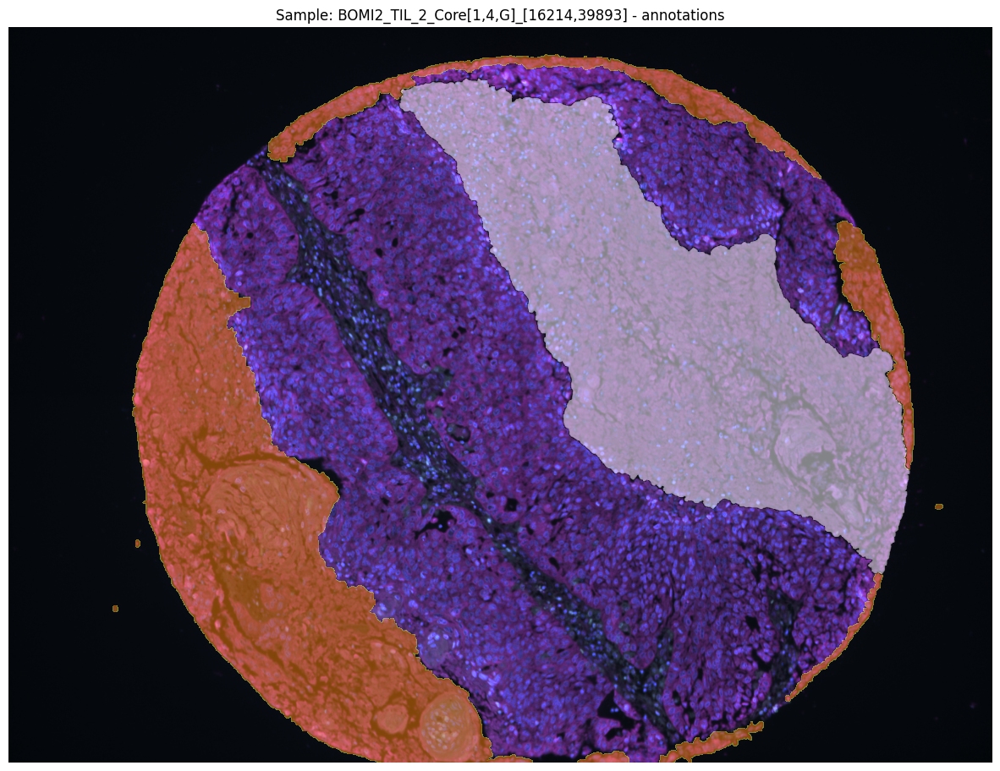

In [19]:
print(f"Original shape: {wsi_samples[0]['original'].shape}")
print(f"Annotation (one channel) original shape: {wsi_samples[0]['annotation'][0].shape}")
print(f"Annotation resized shape: {wsi_samples[0]['annotation'][0].resize_(1000, 1336).shape}")
print(f"Annotation resized shape: {F.resize(wsi_samples[0]['annotation'][0].unsqueeze(0), [1000,1336]).shape}")

plot_sample(wsi_samples[0])
plot_sample(wsi_samples[random.randint(1,len(wsi_samples))])

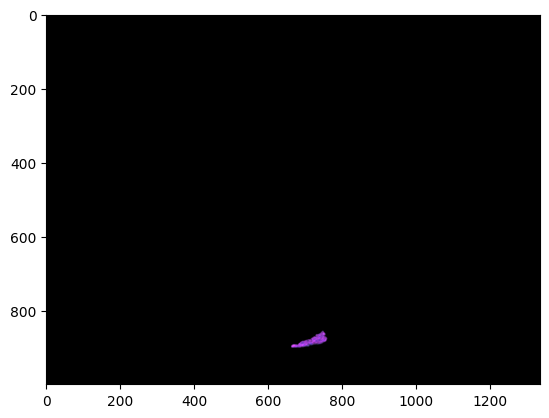

In [20]:
plt.imshow(wsi_samples[0]['segments'][20].permute(1,2,0))

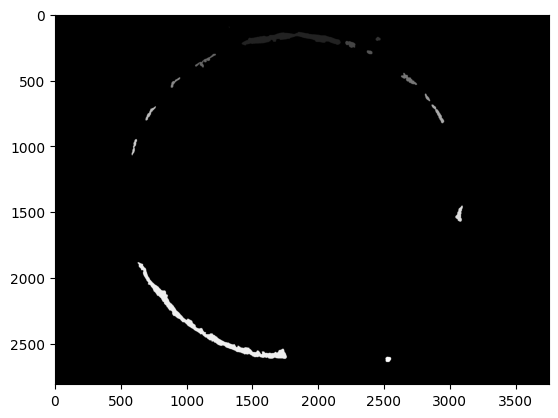

In [21]:
labeled = measure.label(wsi_samples[1]['annotation'][0], connectivity=2)
plt.imshow(labeled, cmap="gray")

In [22]:
print(np.unique(labeled))

[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15]


# 2. CLUSTERIZATION 💚

### 2.1 Saving segments

Size of new segment: torch.Size([3, 244, 244])


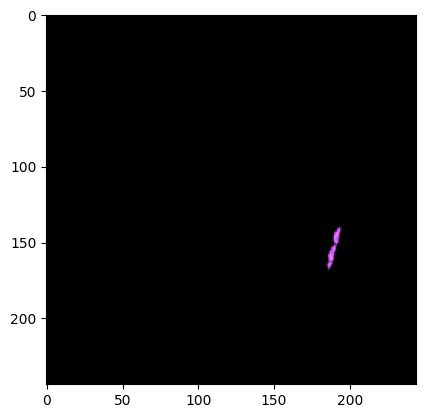

In [ ]:
right_size = F.resize(wsi_samples[0]['segments'][12], [244,244])
print(f"Size of new segment: {right_size.shape}")
plt.imshow(right_size.cpu().permute(1, 2, 0))

torch.Size([3, 244, 244])
torch.Size([244, 244])


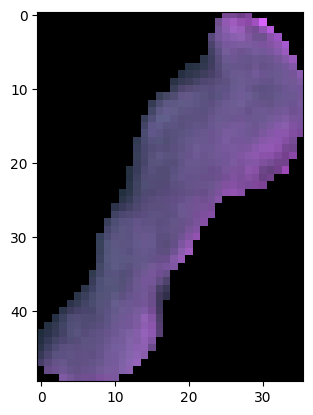

In [ ]:
print(right_size.shape)

print(right_size.sum(dim=0).shape)

non_zero_indices = torch.nonzero(wsi_samples[13]['segments'][5].sum(dim=0))
if non_zero_indices.numel() > 0:
    min_x = torch.min(non_zero_indices[:, 0]).item()
    max_x = torch.max(non_zero_indices[:, 0]).item()
    min_y = torch.min(non_zero_indices[:, 1]).item()
    max_y = torch.max(non_zero_indices[:, 1]).item()
else:
    # Handle the case when there are no non-zero indices
    min_x = max_x = min_y = max_y = 0  # or any other appropriate value

# Crop the segment based on the bounding box
cropped_segment = wsi_samples[13]['segments'][5][:, min_x:max_x+1, min_y:max_y+1]

plt.imshow(cropped_segment.cpu().permute(1, 2, 0))

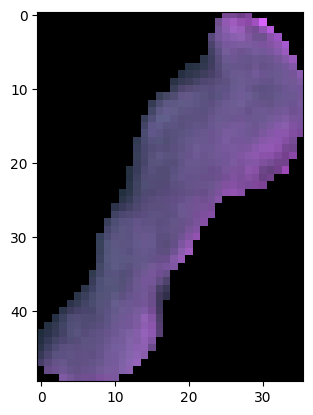

In [ ]:
image = ToPILImage()(cropped_segment)
plt.imshow(image)

In [ ]:
from torchvision.utils import save_image
output_path = '/content/drive/MyDrive/pathdata/segments_with_padding'

for i, sample in tqdm(enumerate(wsi_samples, start=89)):

    for j, segment in enumerate(wsi_samples[i]['segments']):

      # Cropping segment as bounding box
      non_zero_indices = torch.nonzero(segment.sum(dim=0))
      if non_zero_indices.numel() > 0:
          min_x = torch.min(non_zero_indices[:, 0]).item()
          max_x = torch.max(non_zero_indices[:, 0]).item()
          min_y = torch.min(non_zero_indices[:, 1]).item()
          max_y = torch.max(non_zero_indices[:, 1]).item()
      else:
          # case when there are no non-zero indices
          min_x = max_x = min_y = max_y = 0

      # Crop the segment based on the bounding box
      cropped_segment = segment[:, min_x:max_x+1, min_y:max_y+1]

      image = ToPILImage()(cropped_segment)

      # Save image to Google Drive
      image_path = os.path.join(output_path, f'{wsi_samples[i]["id"]}_seg_{j}.png')
      save_image(cropped_segment, image_path)
      #image.save(image_path)

    print(f"Saved {len(wsi_samples[i]['segments'])} segments of {wsi_samples[i]['id']}")

0it [00:00, ?it/s]

Saved 36 segments of BOMI2_TIL_2_Core[1,2,I]_[19644,36225]
Saved 47 segments of BOMI2_TIL_2_Core[1,2,J]_[21406,35844]
Saved 24 segments of BOMI2_TIL_2_Core[1,3,A]_[5546,38654]
Saved 31 segments of BOMI2_TIL_2_Core[1,3,D]_[10785,38273]
Saved 33 segments of BOMI2_TIL_2_Core[1,3,E]_[12595,38130]
Saved 25 segments of BOMI2_TIL_2_Core[1,3,F]_[14309,38083]


KeyboardInterrupt: 

Attempting to pad images to not crop images to their original size, but

In [ ]:
output_path = '/content/drive/MyDrive/pathdata/segments_with_padding'

max_width = 0
max_height = 0

for filename in tqdm(os.listdir(output_path)):
    if filename.endswith(".png"):
        # Load the image and get its dimensions
        image = Image.open(os.path.join(output_path, filename))
        width, height = image.size
        # Update max_width and max_height if necessary
        max_width = max(max_width, width)
        max_height = max(max_height, height)

print(max_height, max_width)

  0%|          | 0/3467 [00:00<?, ?it/s]

946 941


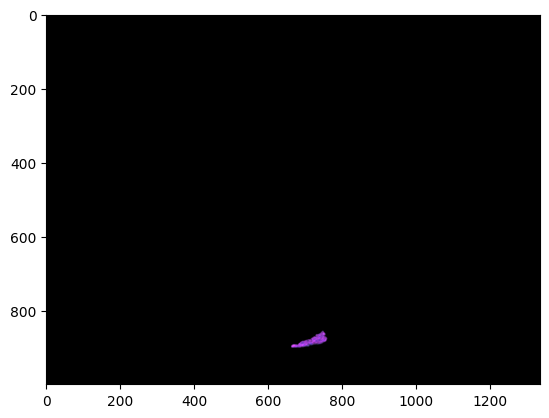

In [ ]:
seg = wsi_samples[0]['segments'][20]
plt.imshow(seg.permute(1,2,0))


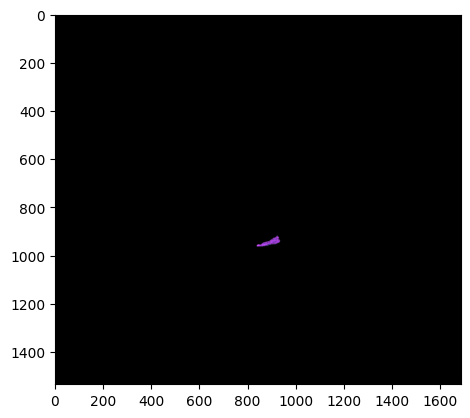

In [ ]:
def crop_center(image, m, n):
  """
  Crop the image around the center of the non-black segment to the fixed size (m, n).

  Args:
      image (torch.Tensor): Input image tensor.
      m (int): Desired height of the cropped image.
      n (int): Desired width of the cropped image.

  Returns:
      torch.Tensor: Cropped image tensor of size (m, n).
  """
  # Find the bounding box around the non-black segment
  non_zero_indices = torch.nonzero(image)
  min_x = non_zero_indices[:, 1].min().item()
  max_x = non_zero_indices[:, 1].max().item()
  min_y = non_zero_indices[:, 0].min().item()
  max_y = non_zero_indices[:, 0].max().item()

  # Calculate the center of the bounding box
  center_x = (min_x + max_x) // 2
  center_y = (min_y + max_y) // 2

  # Calculate the crop boundaries
  crop_x1 = max(center_x - n // 2, 0)
  crop_x2 = min(center_x + n // 2, image.shape[1])
  crop_y1 = max(center_y - m // 2, 0)
  crop_y2 = min(center_y + m // 2, image.shape[0])

  # Crop the image around the center
  cropped_image = image[crop_y1:crop_y2, crop_x1:crop_x2]

  # Pad the cropped image if necessary to ensure fixed size
  if cropped_image.shape[0] < m or cropped_image.shape[1] < n:
      pad_top = max((m - cropped_image.shape[0]) // 2, 0)
      pad_bottom = m - cropped_image.shape[0] - pad_top
      pad_left = max((n - cropped_image.shape[1]) // 2, 0)
      pad_right = n - cropped_image.shape[1] - pad_left
      cropped_image = torch.nn.functional.pad(cropped_image, (pad_left, pad_right, pad_top, pad_bottom))

  return cropped_image


cropped = crop_center(seg, max_height, max_width)
plt.imshow(cropped.permute(1,2,0))


In [ ]:
output_path_2 = '/content/drive/MyDrive/pathdata/segments_with_padding_non_crop'

for i, sample in tqdm(enumerate(wsi_samples, start=89)):

    for j, segment in enumerate(wsi_samples[i]['segments']):

      # Cropping segment as bounding box
      non_zero_indices = torch.nonzero(segment.sum(dim=0))
      if non_zero_indices.numel() > 0:
          min_x = torch.min(non_zero_indices[:, 0]).item()
          max_x = torch.max(non_zero_indices[:, 0]).item()
          min_y = torch.min(non_zero_indices[:, 1]).item()
          max_y = torch.max(non_zero_indices[:, 1]).item()
      else:
          # case when there are no non-zero indices
          min_x = max_x = min_y = max_y = 0

      # Crop the segment based on the bounding box
      cropped_segment = segment[:, min_x:max_x+1, min_y:max_y+1]

      image = ToPILImage()(cropped_segment)

      # Save image to Google Drive
      image_path = os.path.join(output_path_2, f'{wsi_samples[i]["id"]}_seg_{j}.png')
      save_image(cropped_segment, image_path)
      #image.save(image_path)

    print(f"Saved {len(wsi_samples[i]['segments'])} segments of {wsi_samples[i]['id']}")

In [ ]:
! ls /content/drive/MyDrive/pathdata

bin_maps      component_data	segments	       small_segments_18px.txt
bin_maps_old  seg_final_FAILED	segments_with_padding


In [ ]:
# paths = glob('/content/drive/MyDrive/pathdata/segments/*.png')
# small_segments_file = "/content/drive/MyDrive/pathdata/small_segments_18px.txt"

# with open(small_segments_file, "a") as f:

#   for i, sample in tqdm(enumerate(wsi_samples)):

#     for j, segment in enumerate(wsi_samples[i]['segments']):

#       # Cropping segment as bounding box
#       non_zero_indices = torch.nonzero(segment.sum(dim=0))
#       if non_zero_indices.numel() > 0:
#           min_x = torch.min(non_zero_indices[:, 0]).item()
#           max_x = torch.max(non_zero_indices[:, 0]).item()
#           min_y = torch.min(non_zero_indices[:, 1]).item()
#           max_y = torch.max(non_zero_indices[:, 1]).item()
#       else:
#           # case when there are no non-zero indices
#           min_x = max_x = min_y = max_y = 0

#       # Crop the segment based on the bounding box
#       cropped_segment = segment[:, min_x:max_x+1, min_y:max_y+1]
#       image_path = f'/content/drive/MyDrive/pathdata/segments/{wsi_samples[i]["id"]}_seg_{j}.png'


#       if cropped_segment.shape[1]<18 and cropped_segment.shape[2]<18:
#         print("small segment: ", image_path)
#         f.write(image_path + "\n")

#     print(f"Processed {len(wsi_samples[i]['segments'])} segments of {wsi_samples[i]['id']}")

### 2.2 Feature extraction and clustering

For each sample there is a corresponding mask with several (2 for now) channels with purpose of storing layered annotations. All annotated segments per channel are marked with one class. Algorithm includes individual labeling using ```skimage.measure.label()``` which assigns a color class to each instance. Then for each instance masked image is stored in samples collection with original size

```
From skimage docs:

  1-connectivity     2-connectivity     diagonal connection close-up

      [ ]           [ ]  [ ]  [ ]             [ ]
        |               \  |  /                 |  <- hop 2
  [ ]--[x]--[ ]      [ ]--[x]--[ ]        [x]--[ ]
        |               /  |  \             hop 1
      [ ]           [ ]  [ ]  [ ]

```

In [24]:
paths = glob('/content/drive/MyDrive/pathdata/segments_with_padding/*.png')
excluded_paths_file = "/content/drive/MyDrive/pathdata/small_segments_18px.txt"

# Read the contents of the excluded paths file and store them in a set
with open(excluded_paths_file, "r") as f:
    excluded_paths = [line.replace("segments", "segments_with_padding") for line in f.read().splitlines()] #f.read().splitlines()


clean_paths = list(filter(lambda path: path not in excluded_paths, paths))

print(len(paths))
print(len(clean_paths))

3467
2531


In [25]:
from clustimage import Clustimage
import matplotlib.image as mpimg
import matplotlib.pyplot as plt

In [49]:
#Helper function to display instances of each cluster

def print_images_for_clusters(cl, images_per_row=10, max_rows=5):

    pathnames = cl.results['pathnames']
    results = cl_st1.results
    labels = list(results['labels'])

    unique_labels = sorted(set(labels))

    for label in unique_labels:
        print(f"Cluster {label}:")

        # indexes of images belonging to cluster
        cluster_indices = [i for i, l in enumerate(labels) if l == label]

        num_images_to_display = min(images_per_row * max_rows, len(cluster_indices))
        num_rows = min(max_rows, -(-num_images_to_display // images_per_row))

        fig, axs = plt.subplots(num_rows, images_per_row, figsize=(images_per_row*2, num_rows*2))
        fig.suptitle(f"Samples for cluster {label}", fontsize=16)

        for i, ax in enumerate(axs.flat):
            if i < num_images_to_display:
                image_path = pathnames[cluster_indices[i]]
                image = mpimg.imread(image_path)
                ax.imshow(image)
                ax.axis('off')

        plt.tight_layout()
        plt.show()

**Strategy 1** :
* Feature extraction: PCA
* Clustering: Agglomerative
* Input data: with padding, small segments excluded

In [42]:
cl_st1 = Clustimage(method="pca", grayscale=False, dim=(300, 300))
cl_st1.clean_init()
results = cl_st1.fit_transform(clean_paths, min_clust=6, max_clust=20)

[clustimage] >INFO> Cleaning previous fitted model results
[clustimage] >INFO> Cleaning previous fitted model results
[clustimage] >INFO> Reading and checking images.
[clustimage] >INFO> Reading and checking images.
[clustimage]: 100%|██████████| 2531/2531 [00:06<00:00, 367.98it/s]
[clustimage] >INFO> Extracting features using method: [pca]
[clustimage] >INFO> Extracted features using [pca]: samples=2531, features=352
[clustimage] >INFO> Compute [tsne] embedding
[clustimage] >INFO> Cluster evaluation using the [high] feature space of the [pca] features.
[clustimage] >INFO> Saving data in memory.
[clustimage] >INFO> Fit with method=[agglomerative], metric=[euclidean], linkage=[ward]
[clustimage] >INFO> Evaluate using silhouette.
[clusteval] >INFO: 100%|██████████| 14/14 [00:01<00:00,  7.78it/s]
[clustimage] >INFO> Compute dendrogram threshold.
[clustimage] >INFO> Optimal number clusters detected: [8].
[clustimage] >INFO> Fin.
[clustimage] >INFO> Updating cluster-labels and cluster-model

[clustimage] >INFO> Create scatterplot


[pca]> [WARNING]: De parameter <label> is deprecated and will not be supported in future version.


(<Figure size 2500x1500 with 1 Axes>,
 <Axes: title={'center': '352 Principal Components explain [95.02%] of the variance'}, xlabel='PC1 (22.7% expl.var)', ylabel='PC2 (14.1% expl.var)'>)

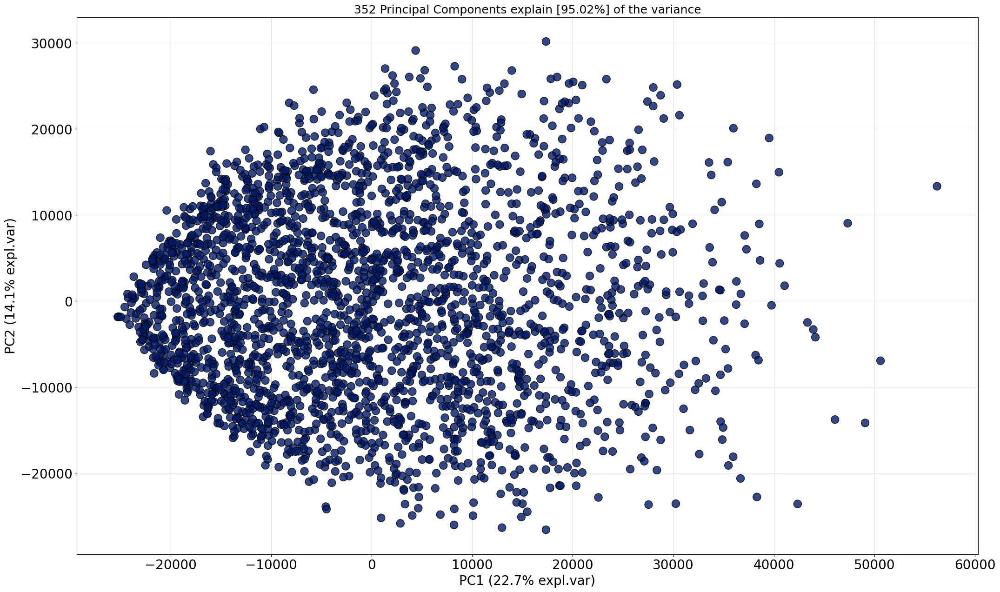

In [44]:
cl_st1.pca.scatter(legend=False, label=False)

In [ ]:
cl_st1.results

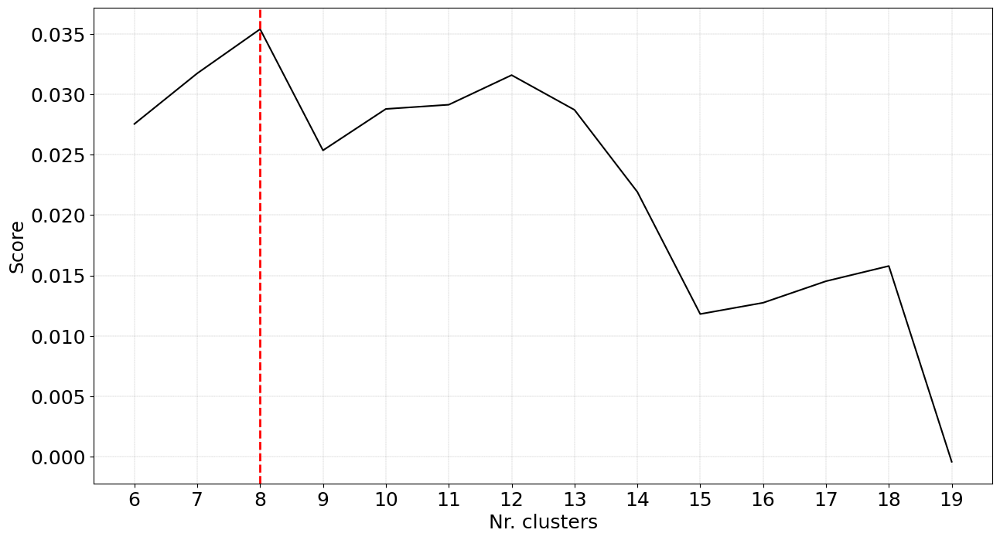

(<Figure size 1500x800 with 1 Axes>,
 <Axes: xlabel='Nr. clusters', ylabel='Score'>)

In [45]:
cl_st1.clusteval.plot()

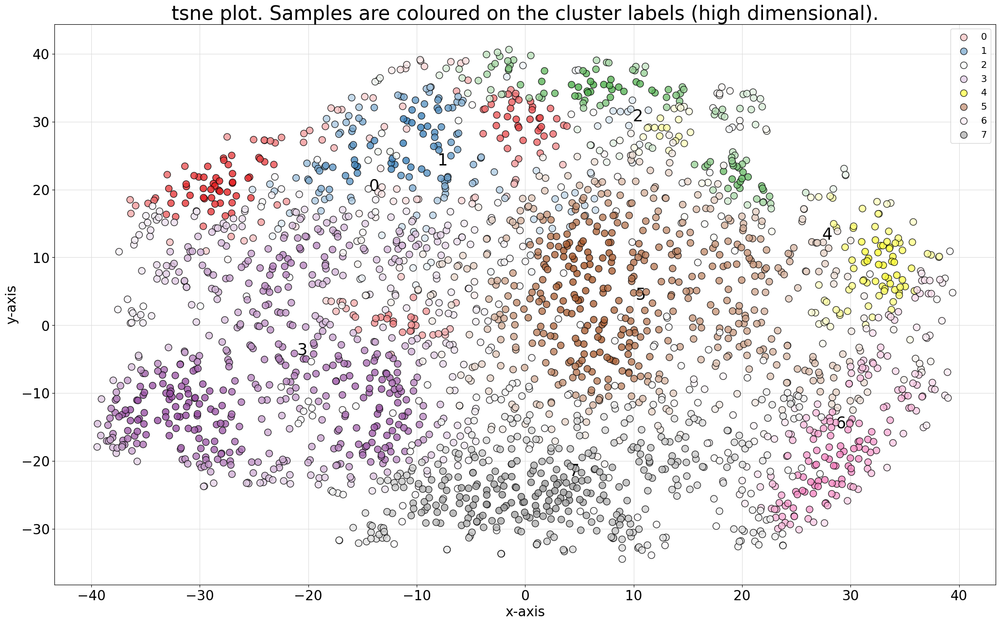

(<Figure size 2500x1500 with 1 Axes>,
 <Axes: title={'center': 'tsne plot. Samples are coloured on the cluster labels (high dimensional).'}, xlabel='x-axis', ylabel='y-axis'>)

<Figure size 640x480 with 0 Axes>

In [46]:
#cl_st1.scatter(dotsize=100, figsize=(25, 15), args_scatter={'title':'t-SNE plot for cluster visualization for Strategy 1'}) #'fontsize':24, 'gradient':'#FFFFFF', 'cmap':'Set1', 'legend':True

cl_st1.scatter(zoom=None, dotsize=100, figsize=(25, 15), args_scatter={'fontsize':24, 'gradient':'#FFFFFF', 'cmap':'Set1', 'legend':True})

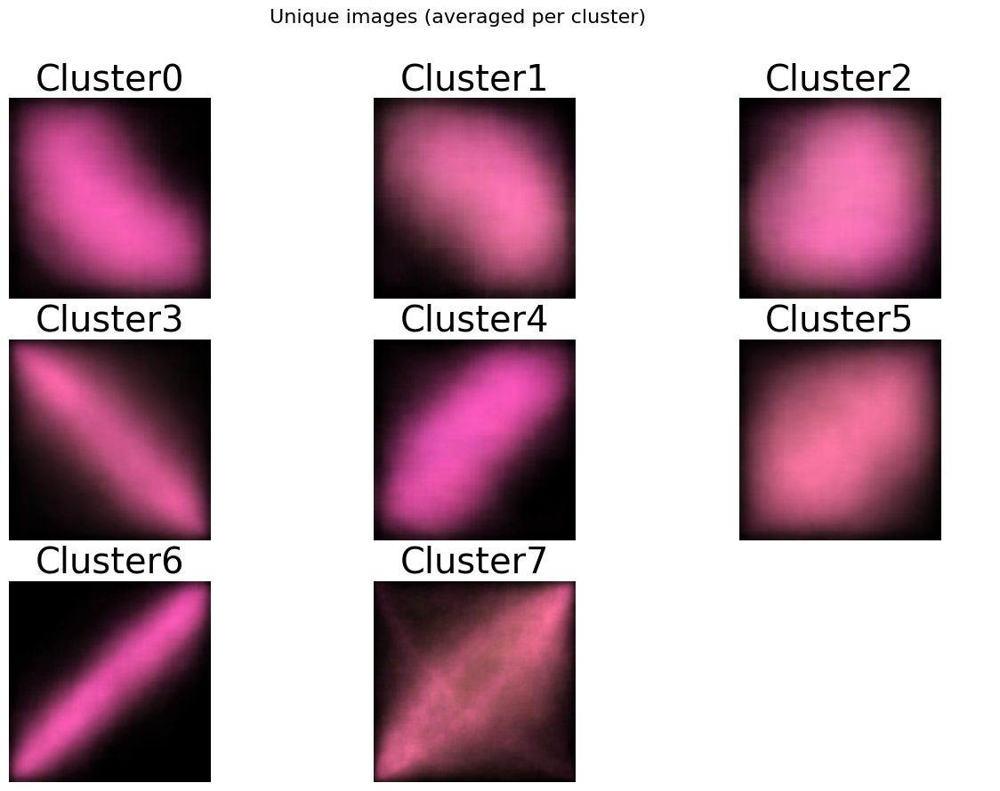

In [47]:
cl_st1.plot_unique()

[clustimage] >INFO> Retrieving input data set.
[clustimage] >INFO> Plotting the dendrogram with optimized settings: metric=euclidean, linkage=ward, max_d=237244.850. Be patient now..
[clustimage] >INFO> Compute cluster labels.


{'icoord': [[25.0, 25.0, 35.0, 35.0],
  [15.0, 15.0, 30.0, 30.0],
  [5.0, 5.0, 22.5, 22.5],
  [65.0, 65.0, 75.0, 75.0],
  [55.0, 55.0, 70.0, 70.0],
  [45.0, 45.0, 62.5, 62.5],
  [13.75, 13.75, 53.75, 53.75],
  [95.0, 95.0, 105.0, 105.0],
  [85.0, 85.0, 100.0, 100.0],
  [115.0, 115.0, 125.0, 125.0],
  [145.0, 145.0, 155.0, 155.0],
  [135.0, 135.0, 150.0, 150.0],
  [120.0, 120.0, 142.5, 142.5],
  [165.0, 165.0, 175.0, 175.0],
  [205.0, 205.0, 215.0, 215.0],
  [195.0, 195.0, 210.0, 210.0],
  [185.0, 185.0, 202.5, 202.5],
  [170.0, 170.0, 193.75, 193.75],
  [131.25, 131.25, 181.875, 181.875],
  [92.5, 92.5, 156.5625, 156.5625],
  [33.75, 33.75, 124.53125, 124.53125],
  [225.0, 225.0, 235.0, 235.0],
  [265.0, 265.0, 275.0, 275.0],
  [255.0, 255.0, 270.0, 270.0],
  [245.0, 245.0, 262.5, 262.5],
  [230.0, 230.0, 253.75, 253.75],
  [295.0, 295.0, 305.0, 305.0],
  [285.0, 285.0, 300.0, 300.0],
  [315.0, 315.0, 325.0, 325.0],
  [292.5, 292.5, 320.0, 320.0],
  [241.875, 241.875, 306.25, 306.25],


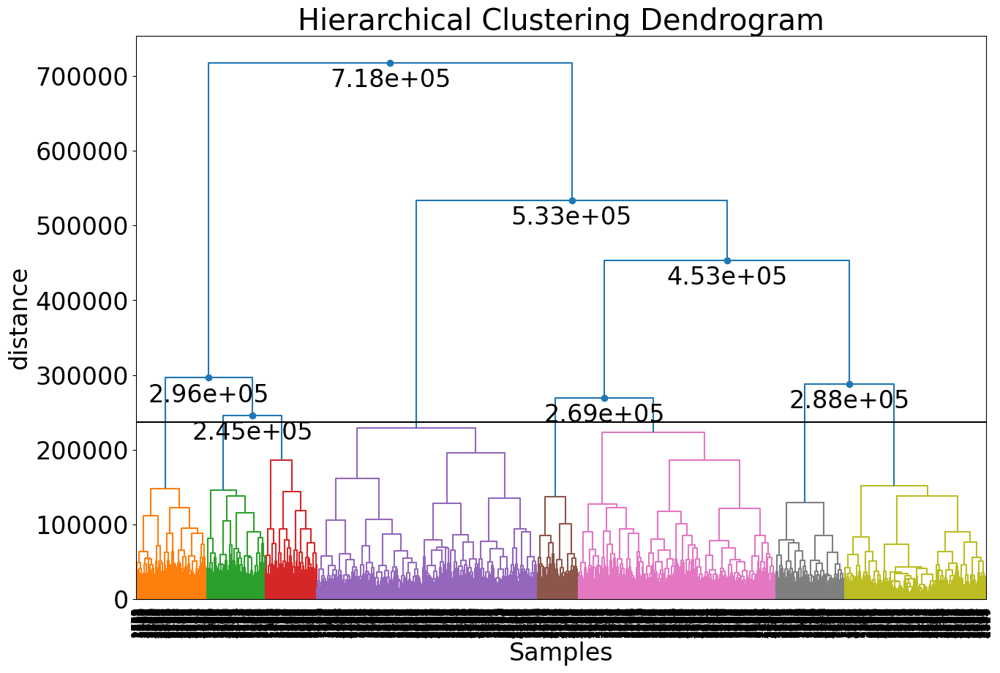

In [50]:
cl_st1.dendrogram()

Cluster 1:


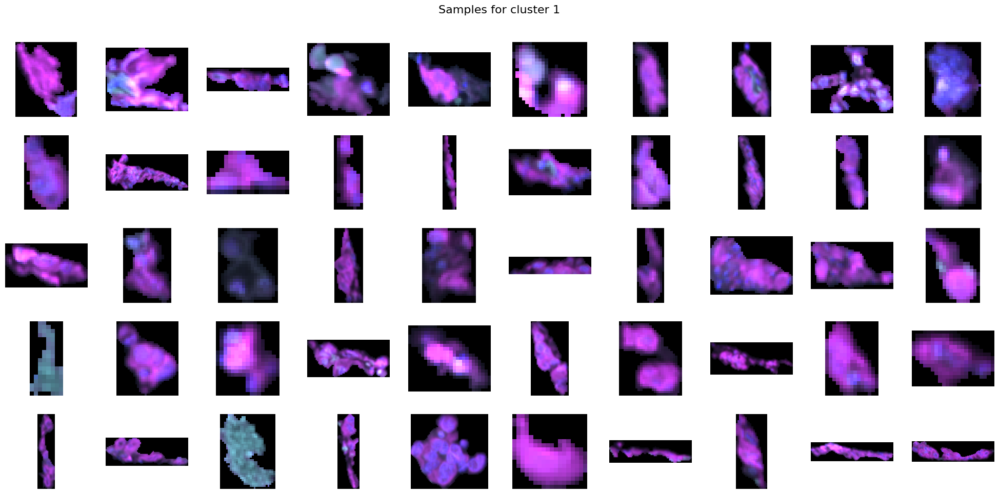

Cluster 2:


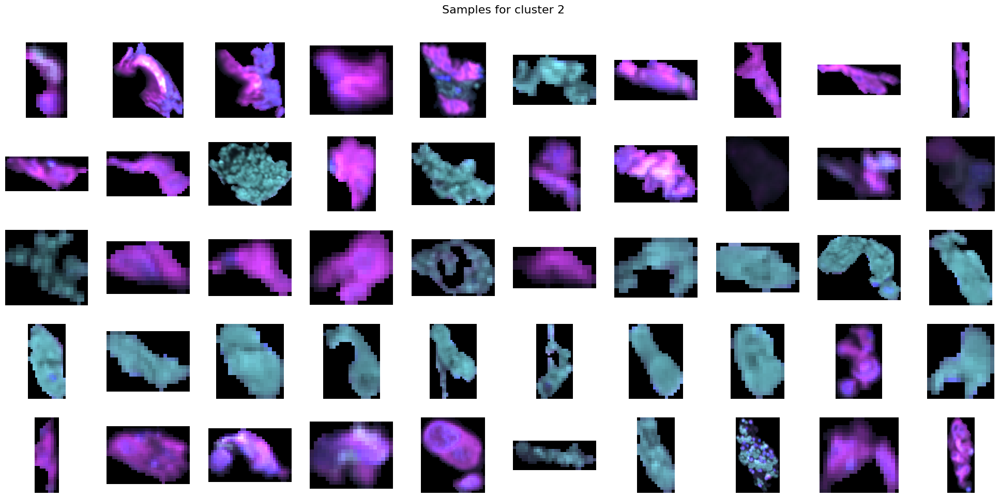

Cluster 3:


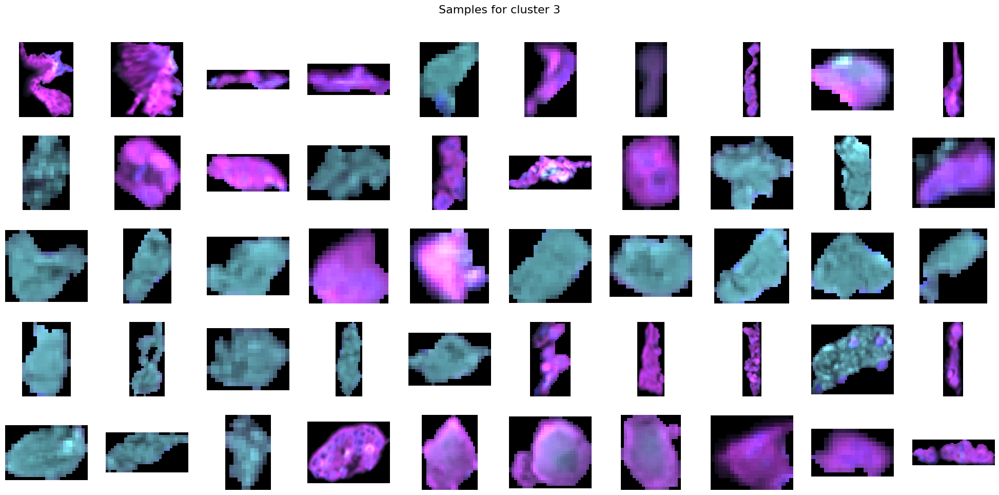

Cluster 4:


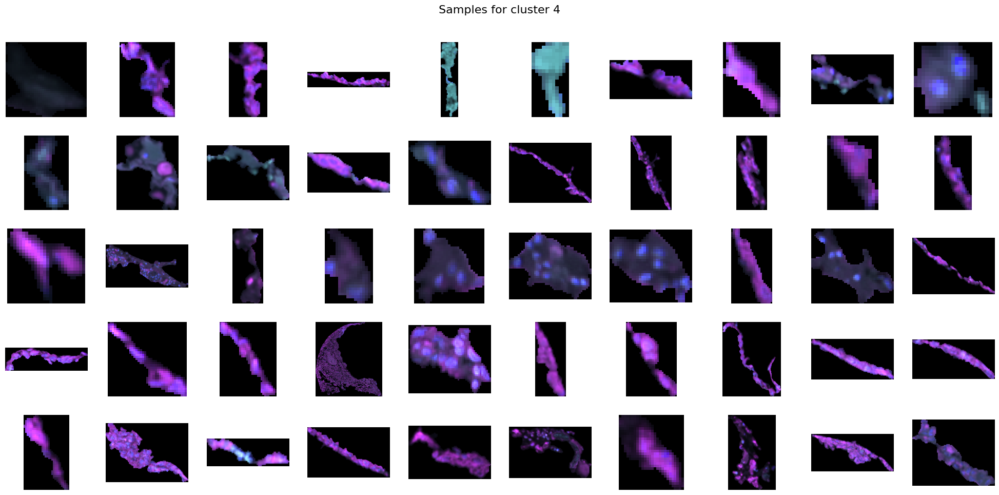

Cluster 5:


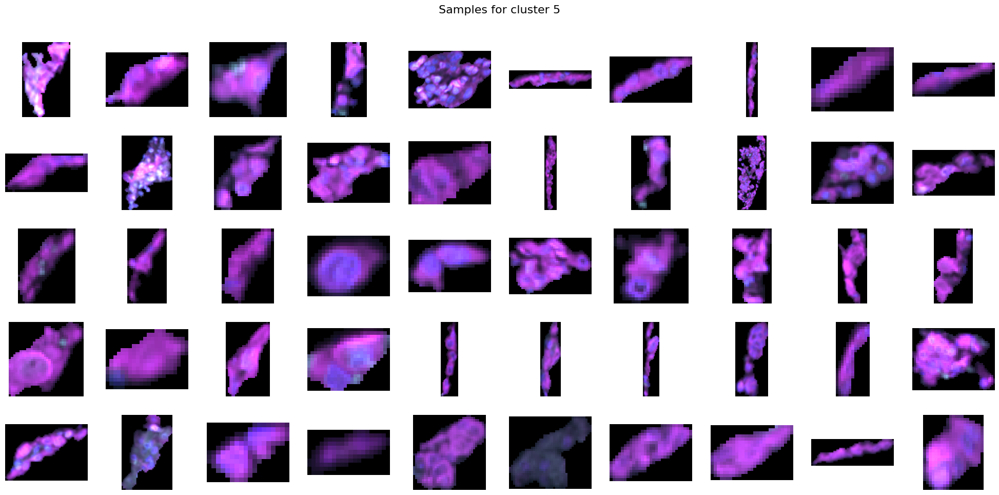

Cluster 6:


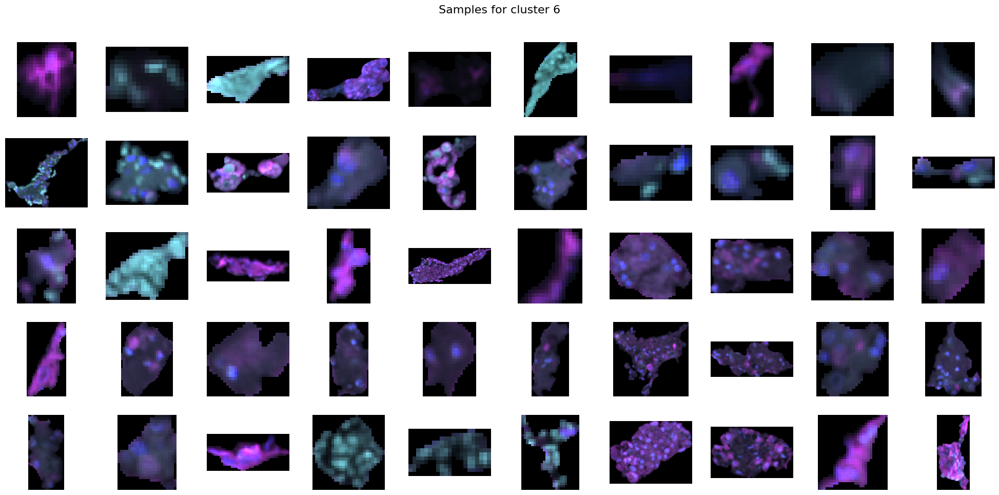

Cluster 7:


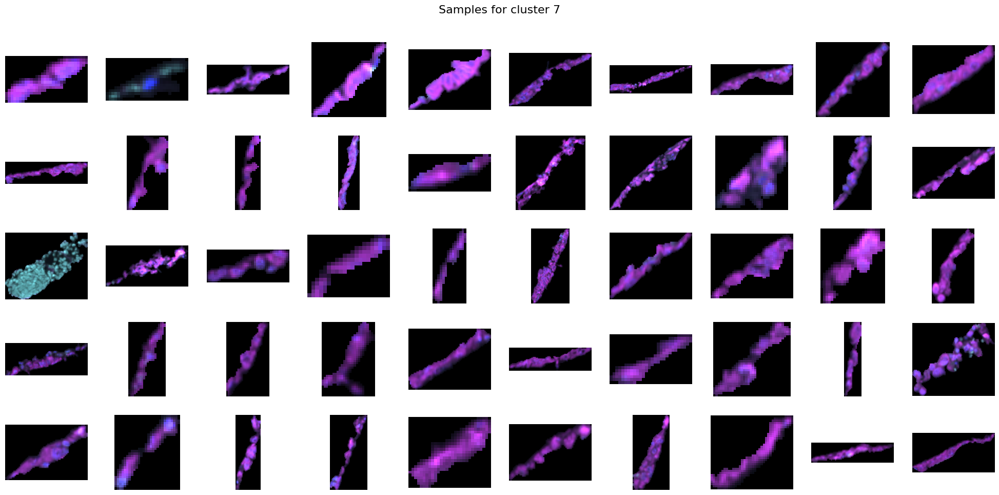

Cluster 8:


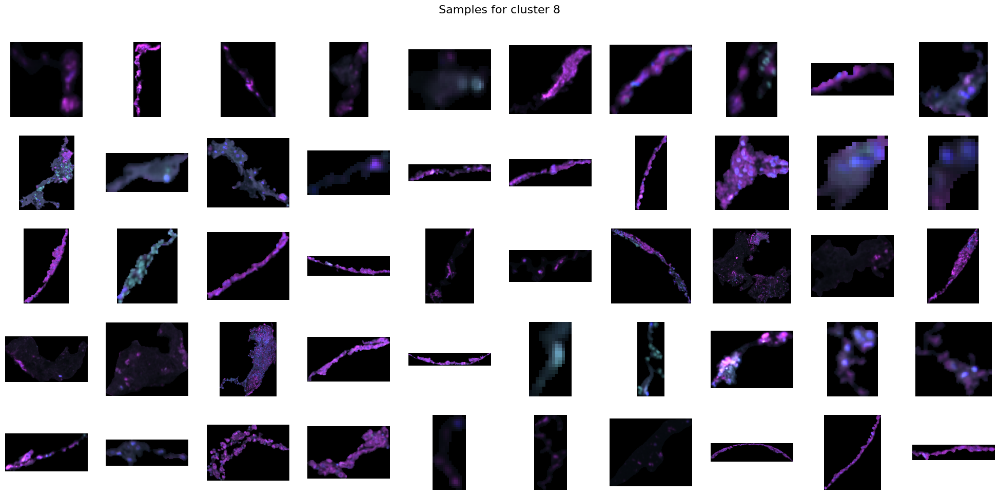

In [51]:
print_images_for_clusters(cl_st1)

In [ ]:
labels = cl.cluster(cluster="dbscan", cluster_space='low', min_clust=5, max_clust=15)

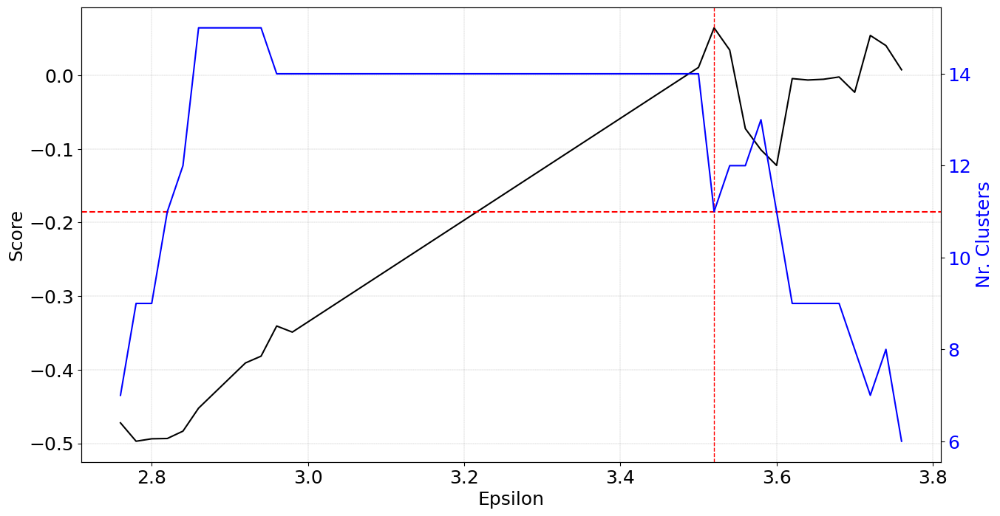

(<Figure size 1500x800 with 2 Axes>,
 (<Axes: xlabel='Epsilon', ylabel='Score'>, <Axes: ylabel='Nr. Clusters'>))

In [ ]:
cl.clusteval.plot()

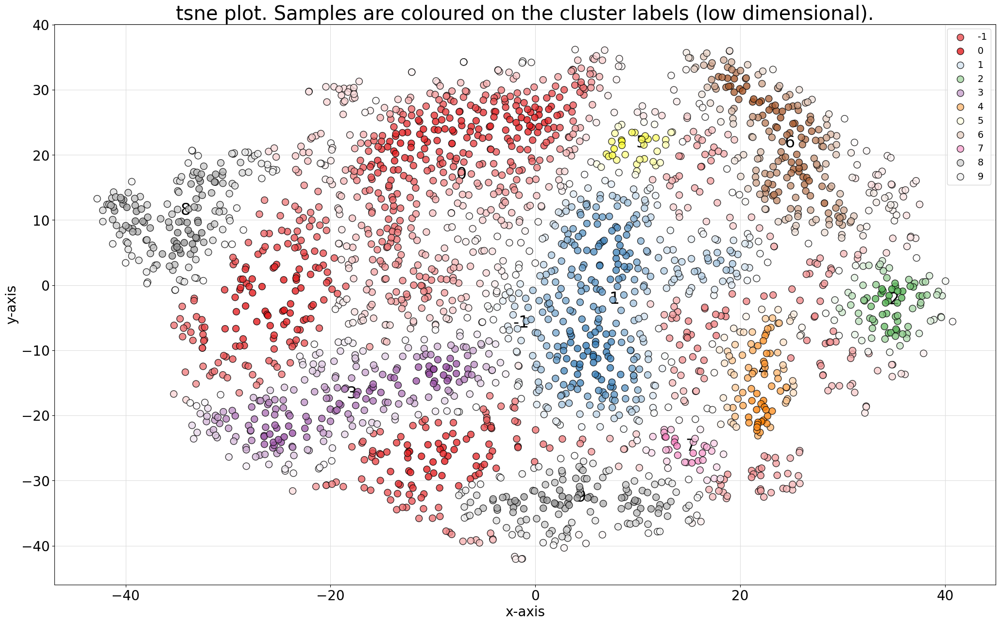

(<Figure size 2500x1500 with 1 Axes>,
 <Axes: title={'center': 'tsne plot. Samples are coloured on the cluster labels (low dimensional).'}, xlabel='x-axis', ylabel='y-axis'>)

<Figure size 640x480 with 0 Axes>

In [ ]:
cl.scatter(zoom=None, dotsize=100, figsize=(25, 15), args_scatter={'fontsize':24, 'gradient':'#FFFFFF', 'cmap':'Set1', 'legend':True})


Cluster -1:


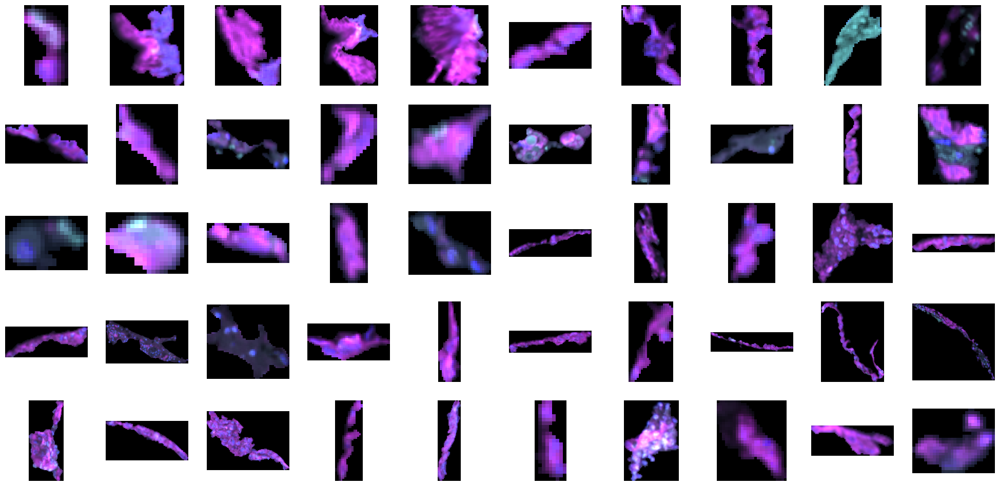

Cluster 0:


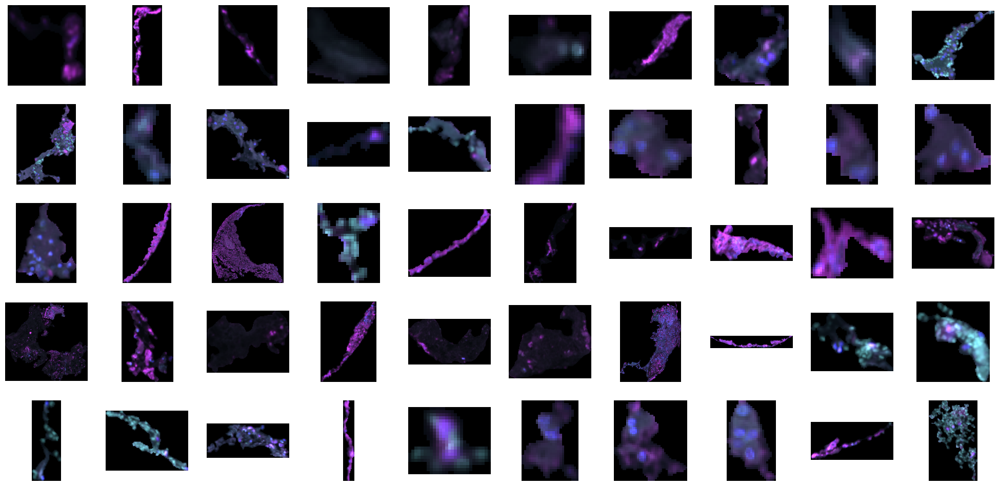

Cluster 1:


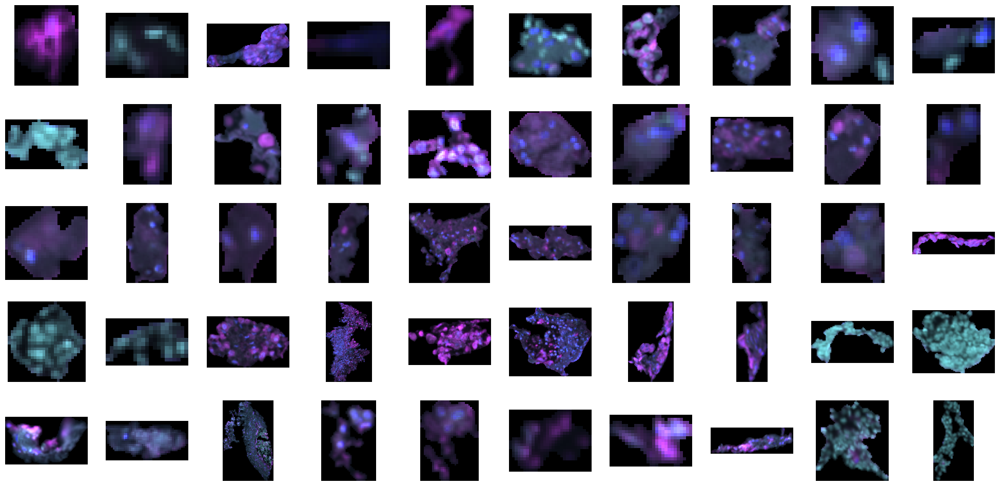

Cluster 2:


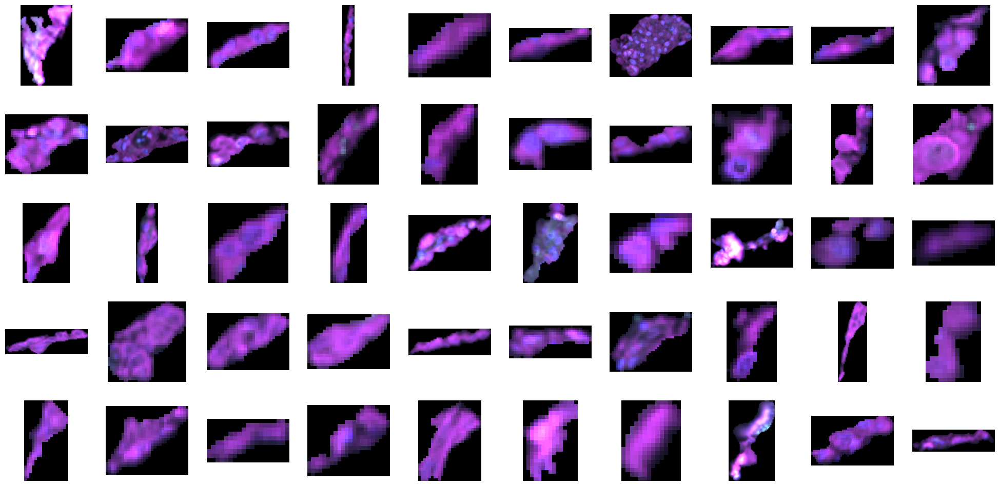

Cluster 3:


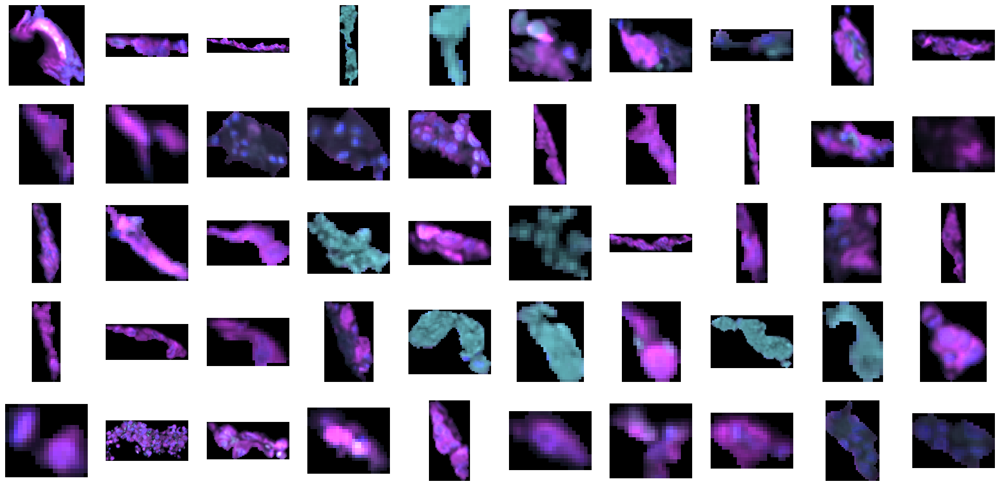

Cluster 4:


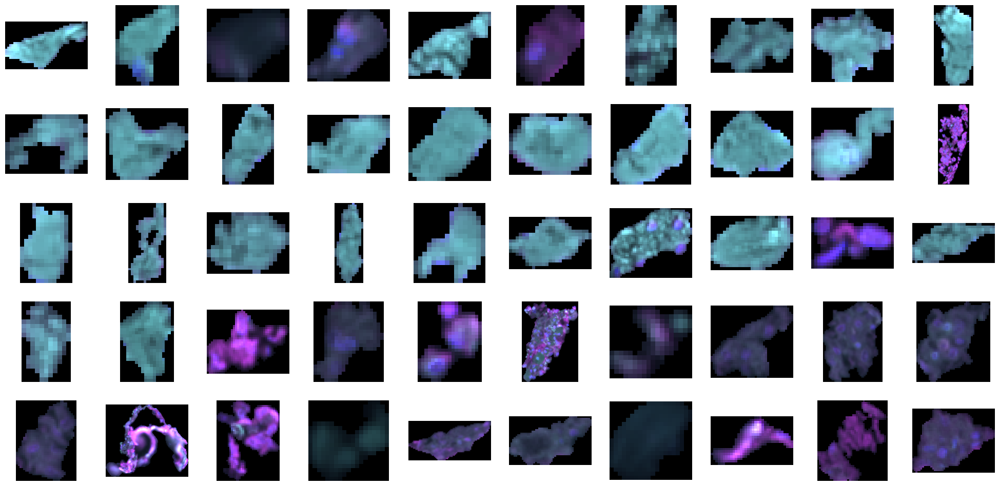

Cluster 5:


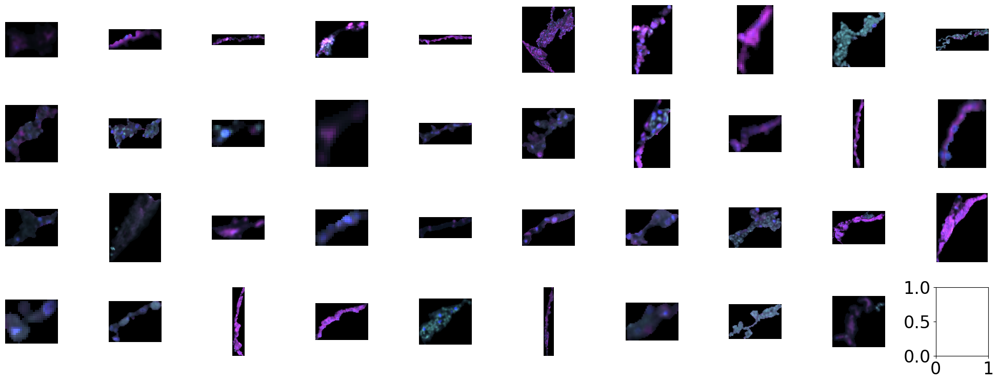

Cluster 6:


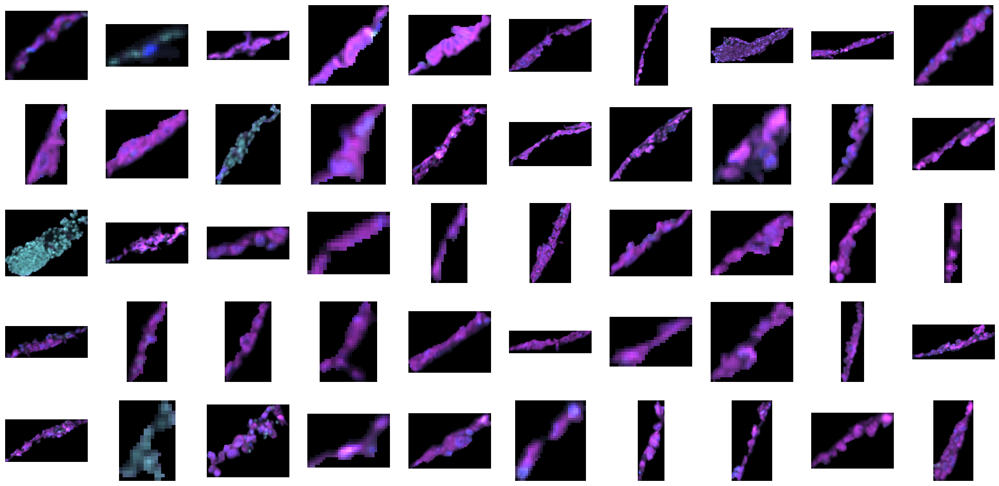

Cluster 7:


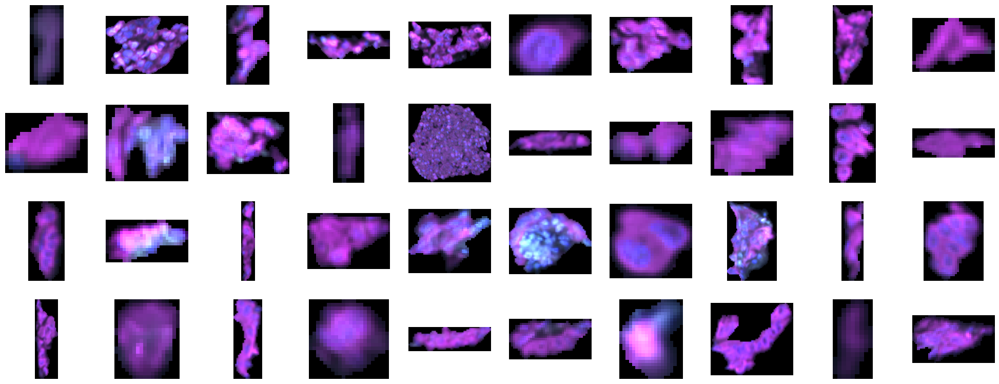

Cluster 8:


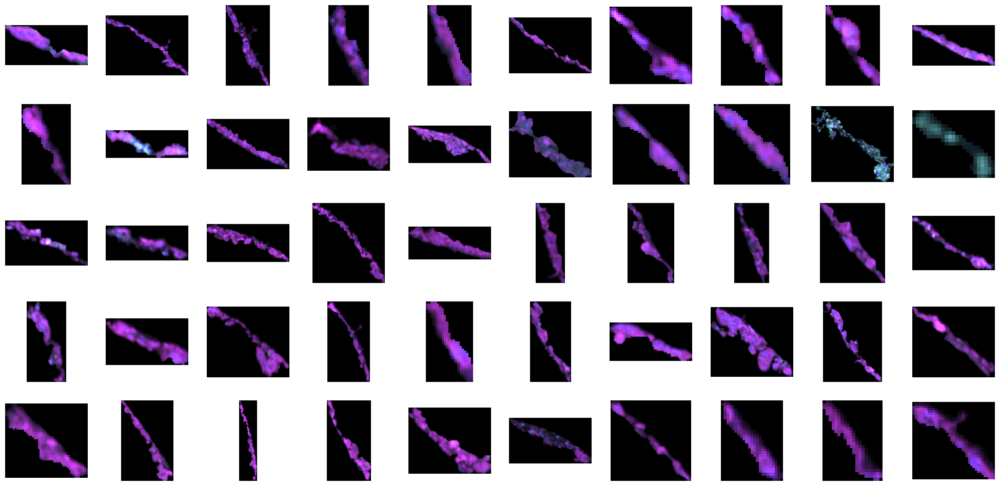

Cluster 9:


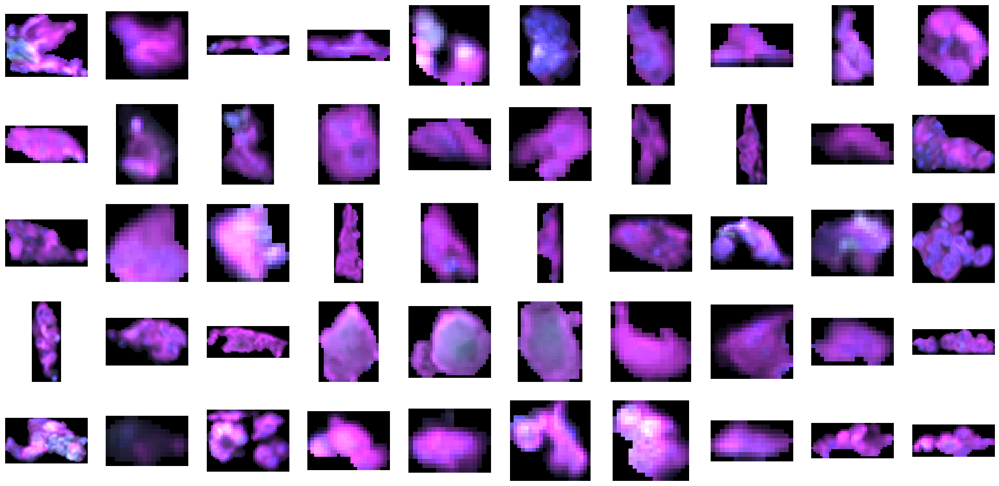

In [ ]:
print_images_for_clusters(cl.results['pathnames'], cl.results['labels'], cl.results, images_per_row=10, max_rows=5)

In [ ]:
cl2 = Clustimage(method="pca-hog", grayscale=False, dim=(320, 320))
cl2.clean_init()
results = cl2.fit_transform(clean_paths, min_clust=5, max_clust=15, cluster="dbscan", cluster_space='low')

[clustimage] >INFO> Cleaning previous fitted model results
[clustimage] >INFO> Cleaning previous fitted model results
[clustimage] >INFO> Reading and checking images.
[clustimage] >INFO> Reading and checking images.
[clustimage]: 100%|██████████| 2531/2531 [00:07<00:00, 326.90it/s]
[clustimage] >INFO> Extracting features using method: [pca-hog]
[clustimage]: 100%|██████████| 2531/2531 [26:58<00:00,  1.56it/s]
[clustimage] >INFO> Extracted features using [pca-hog]: samples=2531, features=426
[clustimage] >INFO> Compute [tsne] embedding
[clustimage] >INFO> Cluster evaluation using the [low] feature space of the [tsne] coordinates.
[clustimage] >INFO> Saving data in memory.
[clustimage] >INFO> Fit with method=[dbscan], metric=[euclidean], linkage=[ward]
[clustimage] >INFO> Gridsearch across Epsilon.
[clustimage] >INFO> Evaluate using silhouette..
[clusteval] >INFO: 100%|██████████| 245/245 [00:19<00:00, 12.31it/s]
[clustimage] >INFO> Compute dendrogram threshold.
[clustimage] >INFO> Optim

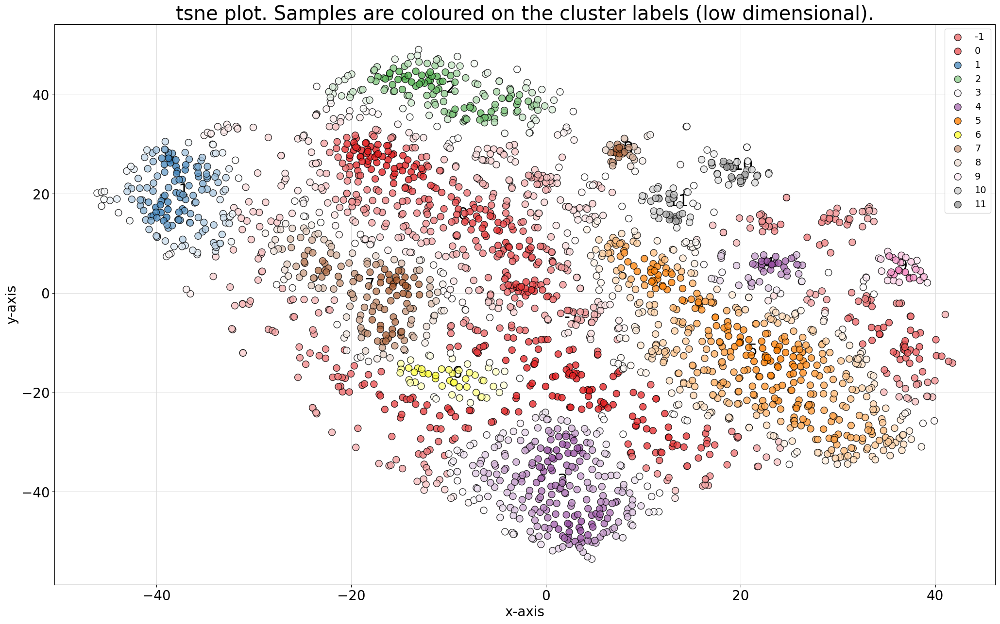

(<Figure size 2500x1500 with 1 Axes>,
 <Axes: title={'center': 'tsne plot. Samples are coloured on the cluster labels (low dimensional).'}, xlabel='x-axis', ylabel='y-axis'>)

<Figure size 640x480 with 0 Axes>

In [ ]:
cl2.scatter(zoom=None, dotsize=100, figsize=(25, 15), args_scatter={'fontsize':24, 'gradient':'#FFFFFF', 'cmap':'Set1', 'legend':True})


Cluster -1:


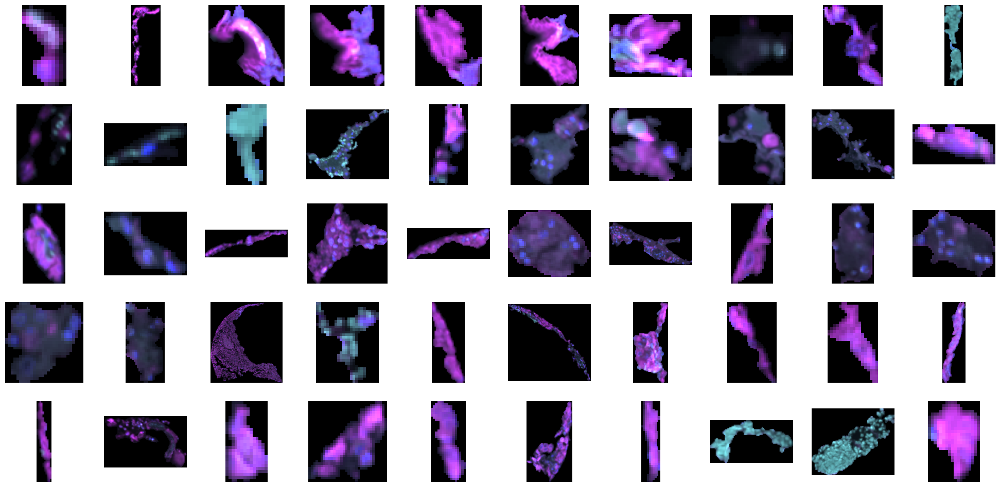

Cluster 0:


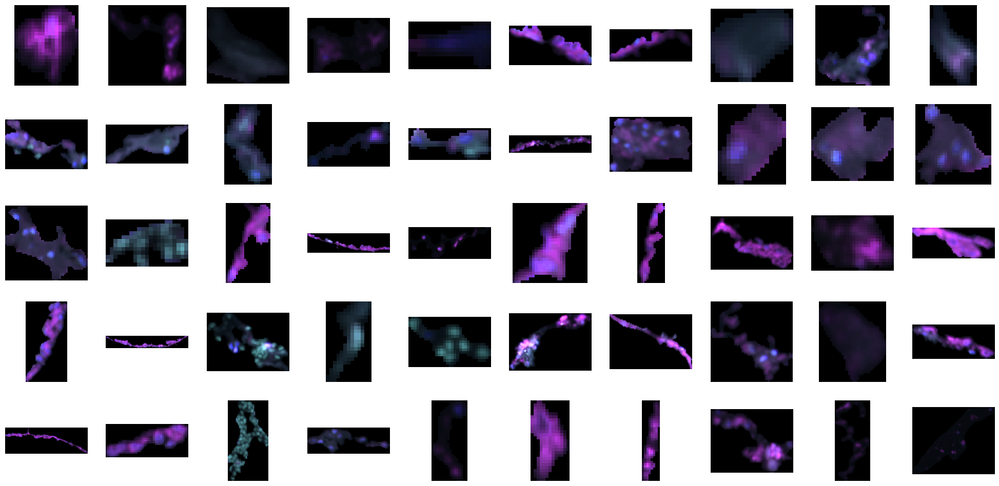

Cluster 1:


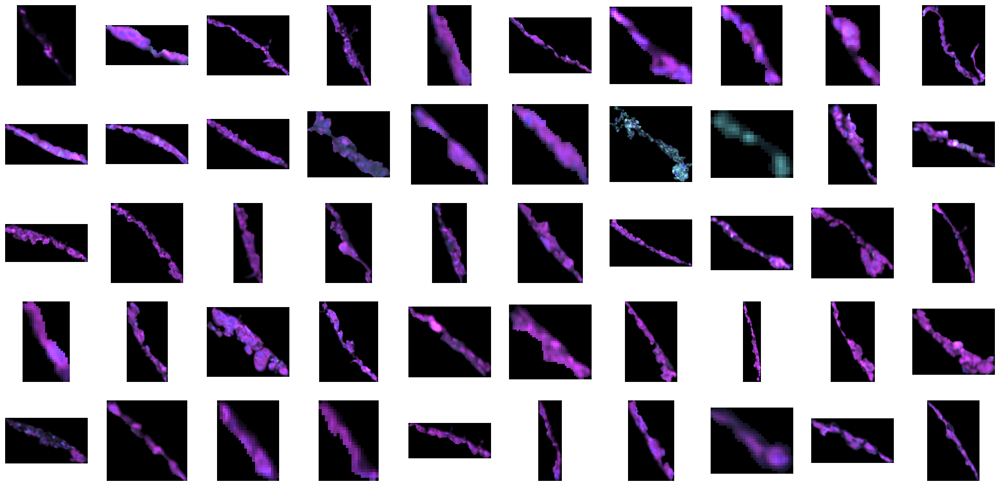

Cluster 2:


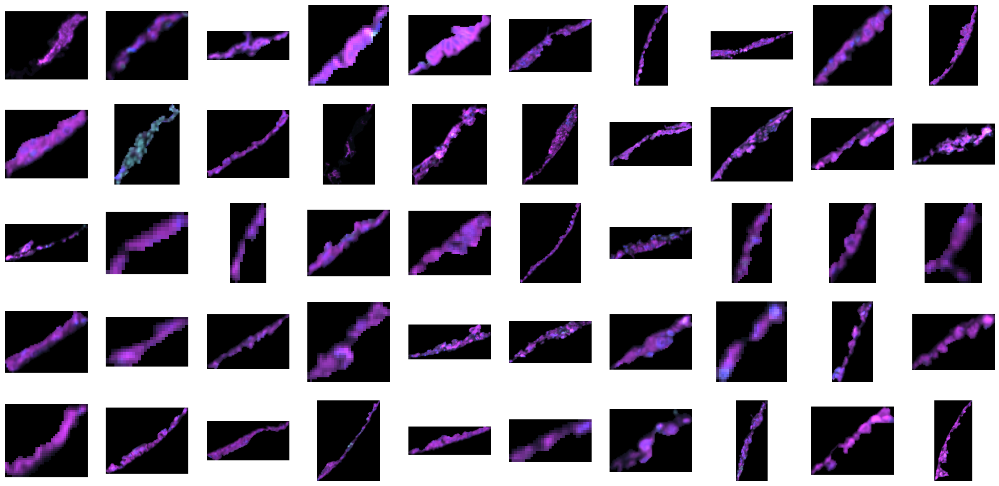

Cluster 3:


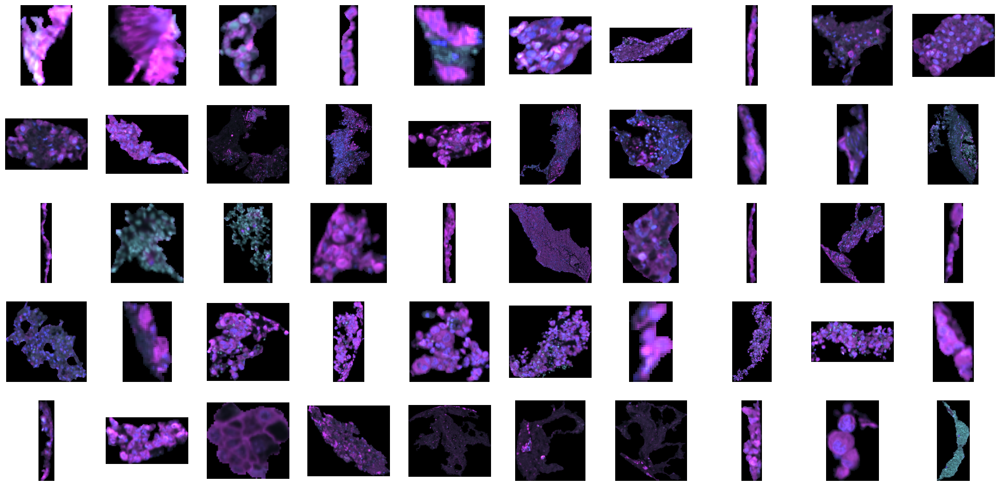

Cluster 4:


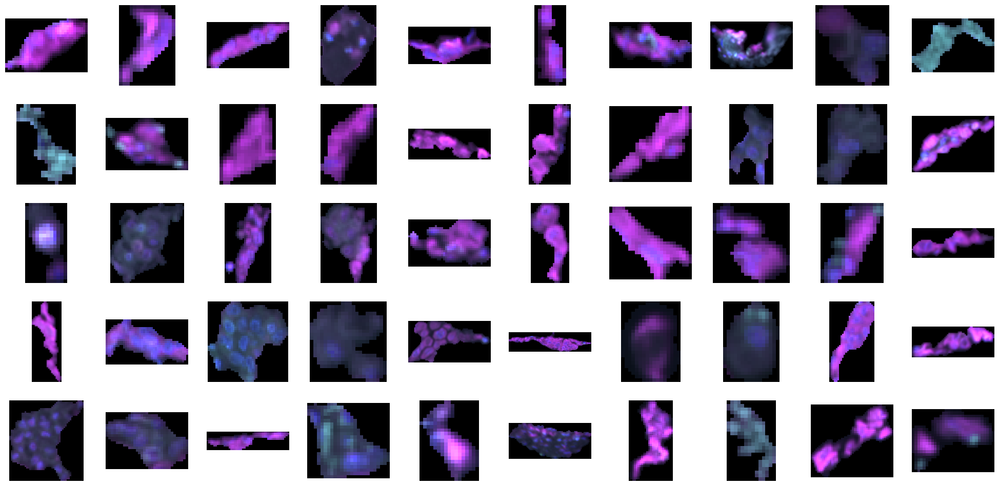

Cluster 5:


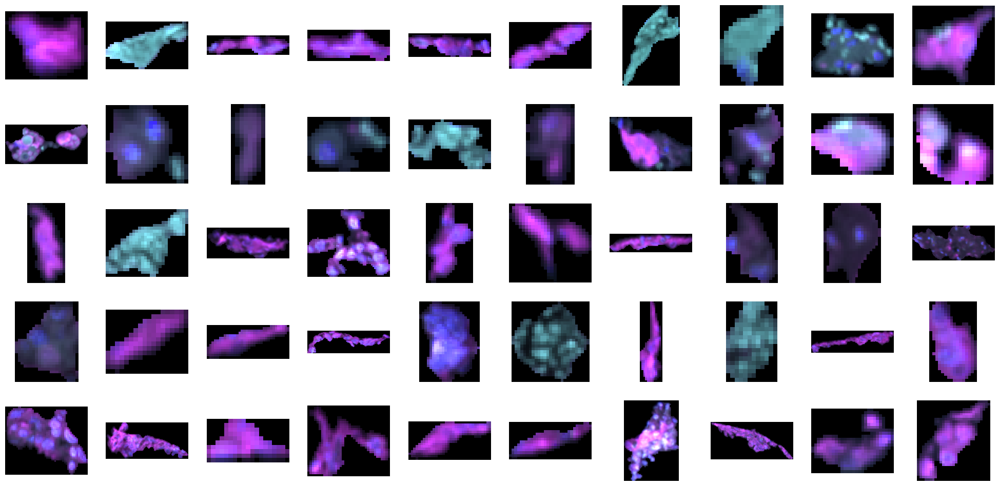

Cluster 6:


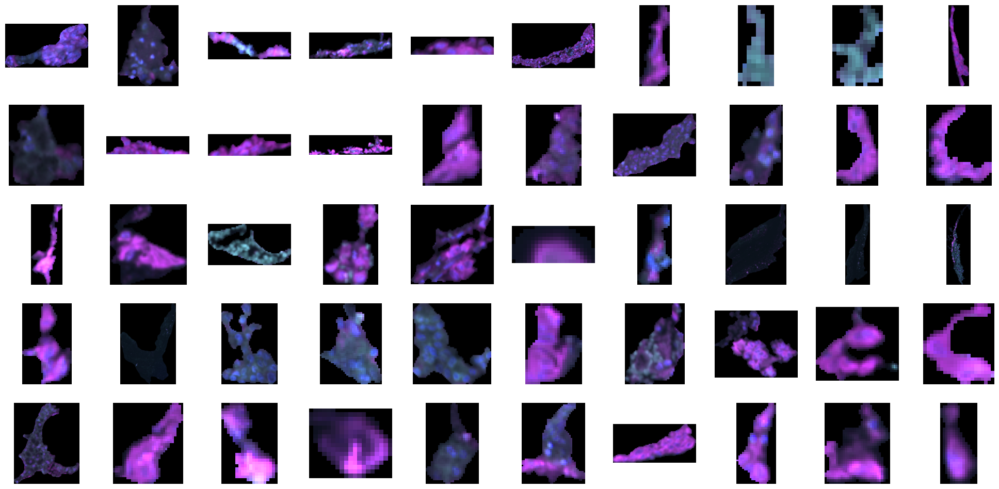

Cluster 7:


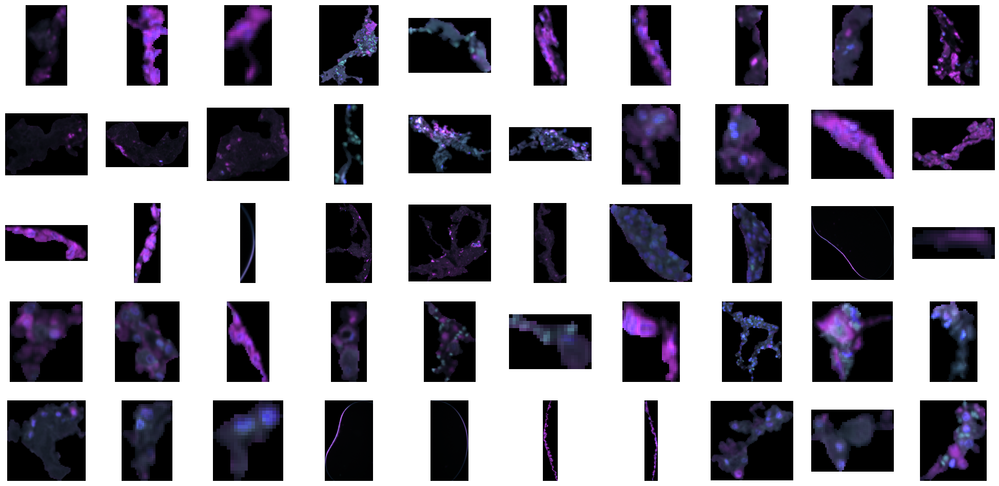

Cluster 8:


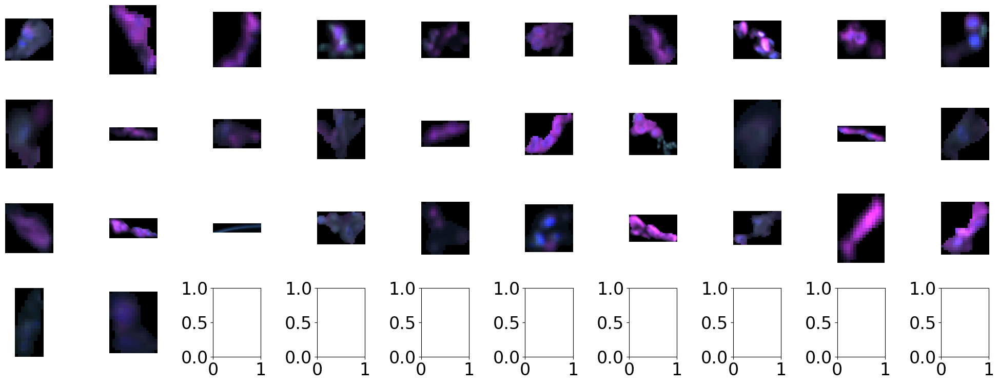

Cluster 9:


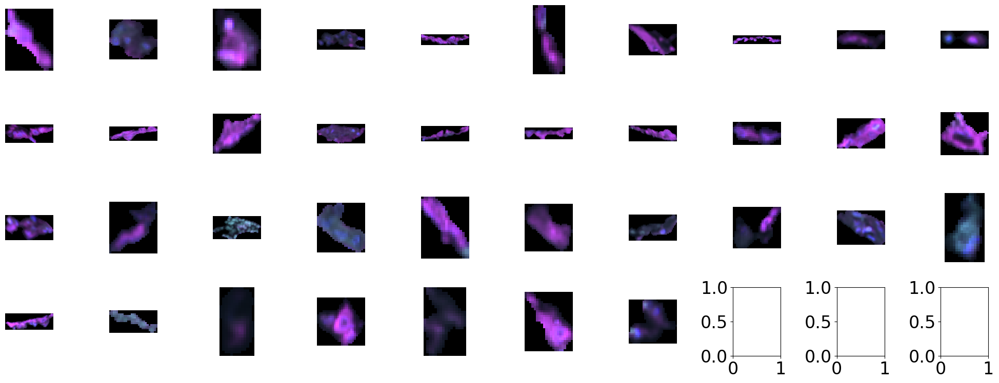

Cluster 10:


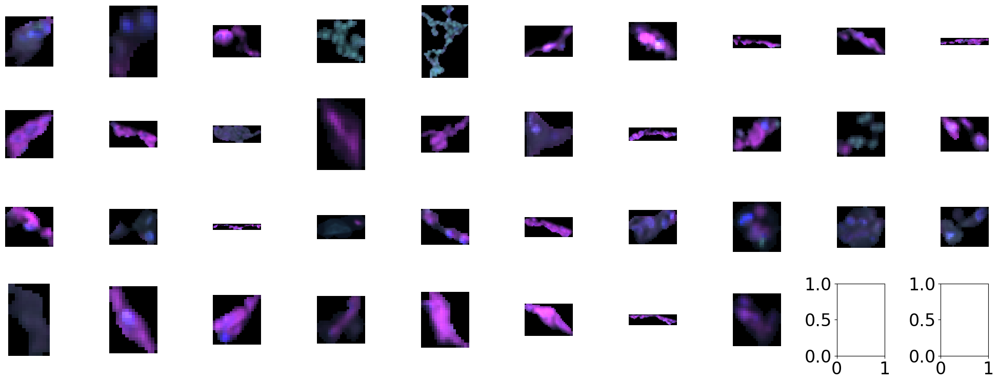

Cluster 11:


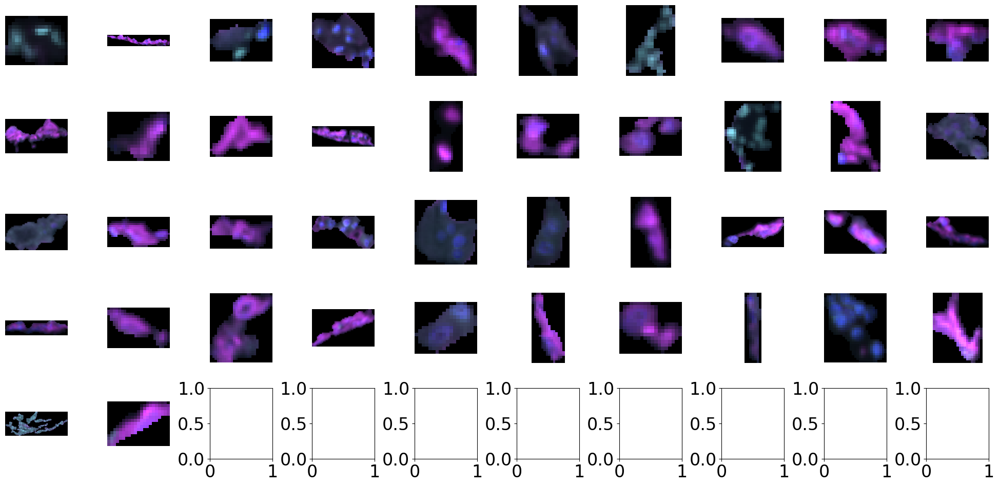

In [ ]:
print_images_for_clusters(cl2.results['pathnames'], cl2.results['labels'], cl2.results, images_per_row=10, max_rows=5)

In [ ]:
https://www.researchgate.net/publication/373163948_Automated_Semiconductor_Defect_Inspection_in_Scanning_Electron_Microscope_Images_a_Systematic_Review

# 3. SEGMENTATION

In [ ]:
! pip install ultralytics

In [ ]:
from ultralytics import YOLO

# Load a model
model = YOLO('yolov8n-seg.yaml')  # build a new model from YAML
model = YOLO('yolov8n-seg.pt')  # load a pretrained model (recommended for training)
model = YOLO('yolov8n-seg.yaml').load('yolov8n.pt')  # build from YAML and transfer weights

# Train the model
results = model.train(data='coco8-seg.yaml', epochs=100, imgsz=640)

## 3.1 Training

## 3.2 Testing

# 4. RESULTS COMPARISON